# Guilak

## 0. Setting up workenvironment<a id="0"></a>

In [1]:
suppressPackageStartupMessages({
    library(DropletUtils)
    library(SingleCellExperiment)
    library(scuttle)
    library(Seurat)
    library(SeuratWrappers)
    library(stringr)
    library(dplyr)
    library(data.table)
    library(Matrix)
    library(patchwork)
    library(ggplot2)
})

options(repr.plot.width = 16, repr.plot.height = 8)

## Loading data

### 3.1. Data analysis Seurat<a id="9"></a>

In [188]:
A <- readRDS(file = "Guilak_E11.5.Rds")

In [189]:
A@meta.data$Author = 'Guilak'

### E11.5

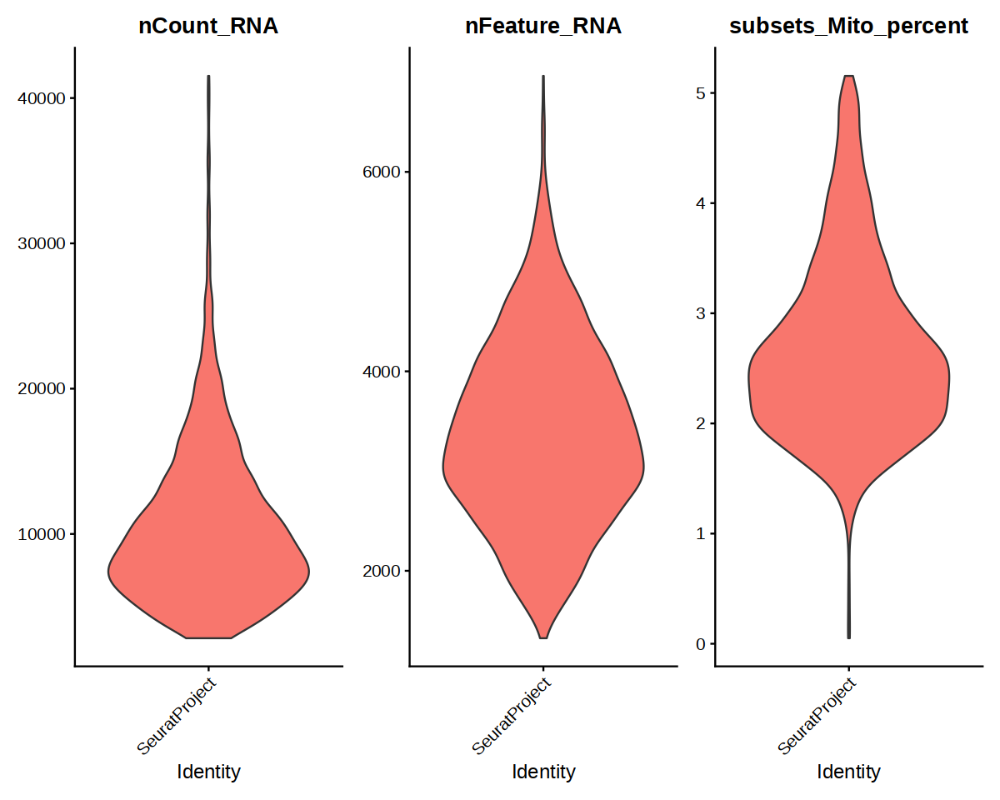

In [191]:
VlnPlot(A, features = c("nCount_RNA", "nFeature_RNA", "subsets_Mito_percent"), 
        ncol = 3, group.by = "orig.ident", pt.size = 0)

In [192]:
A <- NormalizeData(A, verbose = FALSE)
A <- FindVariableFeatures(A, selection.method = "vst", nfeatures = 2000)

# Identify the 10 most highly variable genes
top10 <- head(VariableFeatures(A), 10)

In [193]:
all.genes <- rownames(A)
A <- ScaleData(A, features = all.genes)

Centering and scaling data matrix



In [194]:
A <- RunPCA(A, features = VariableFeatures(object = A), verbose = FALSE)

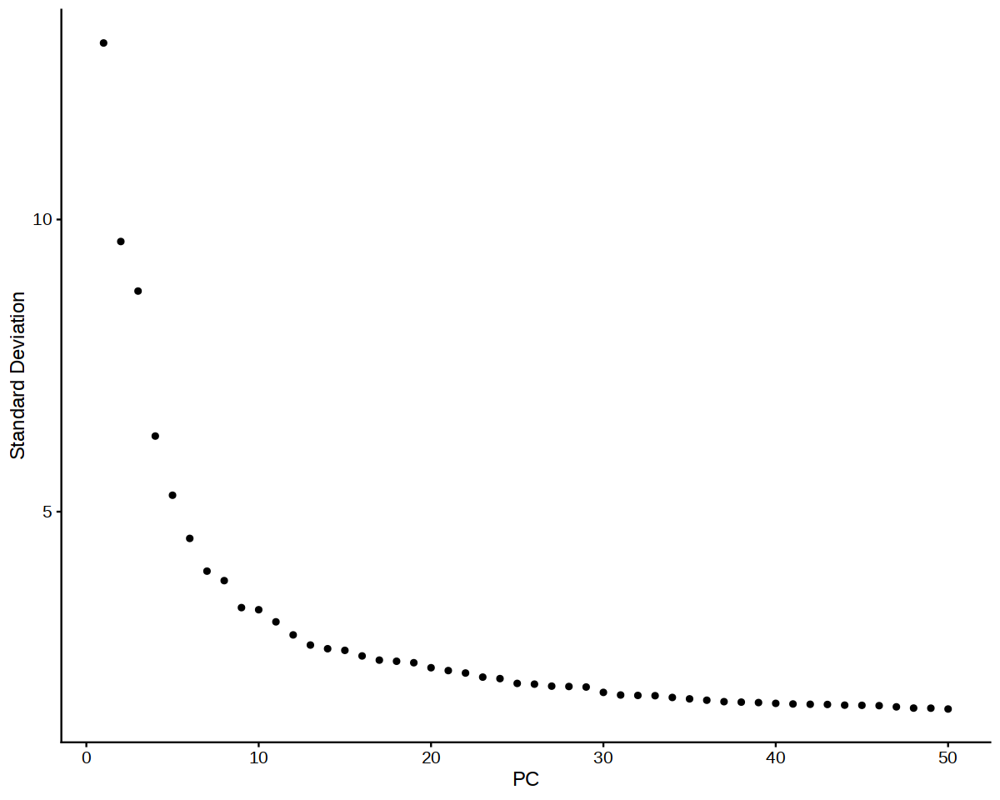

In [195]:
ElbowPlot(A, 50)

In [196]:
A <- FindNeighbors(A, dims = 1:18)
A<- FindClusters(A, resolution = 0.6)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 2453
Number of edges: 73766

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8623
Number of communities: 12
Elapsed time: 0 seconds


In [197]:
A <- RunUMAP(A, dims = 1:18, n.neighbors = 12, verbose = FALSE)

### Check annotation

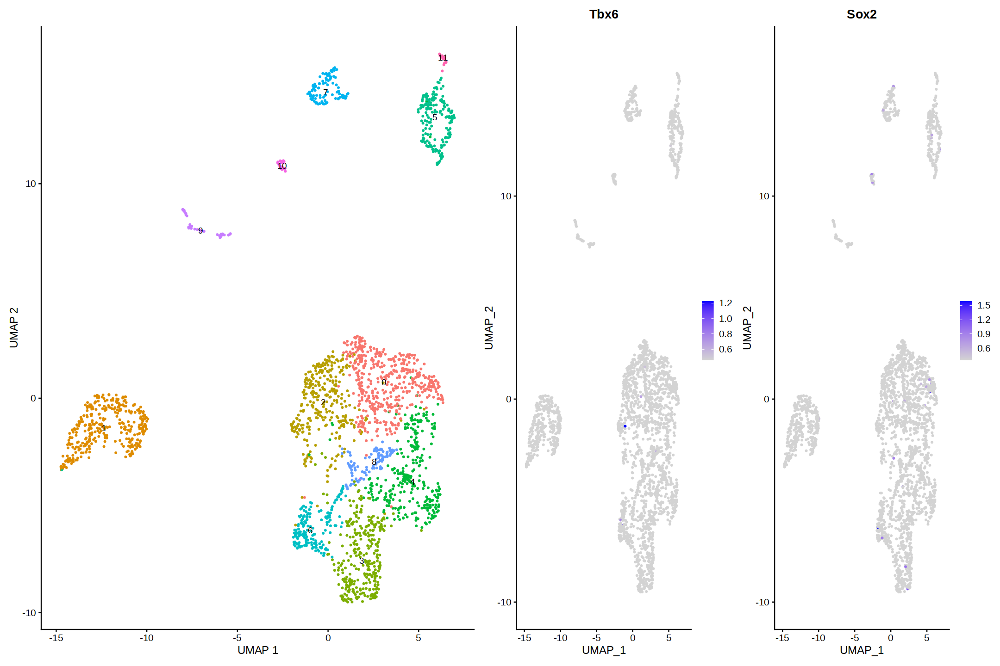

In [12]:
# Paraxial Mesoderm: Tbx6+, Sox2-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Tbx6", "Sox2"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Ren1”


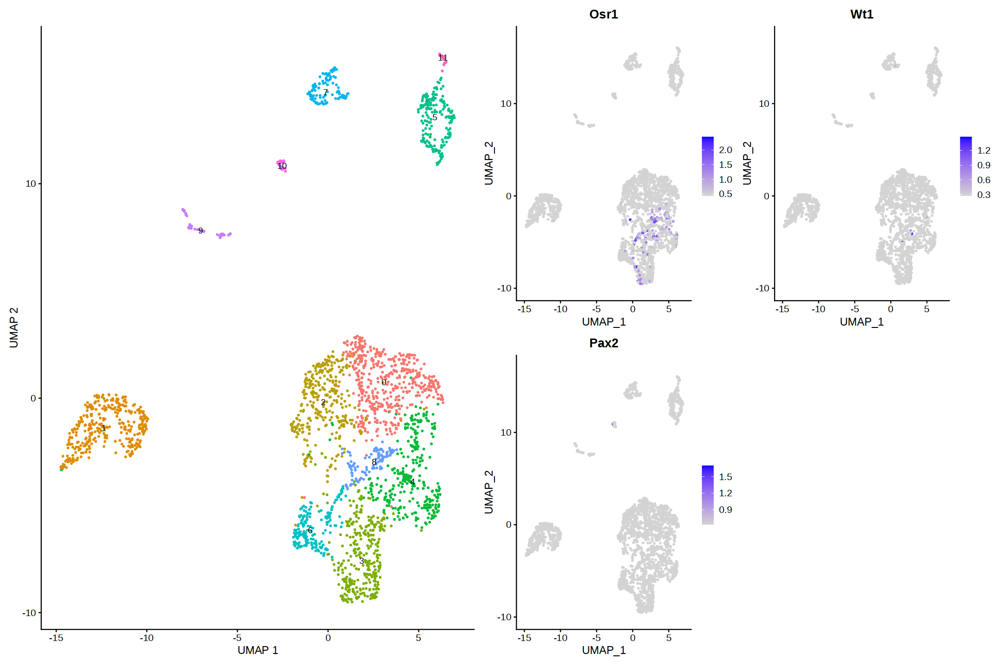

In [13]:
# Intermediate Mesoderm: Osr1, Wt1, Pax2
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Osr1", "Wt1", "Pax2","Ren1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Gata4”


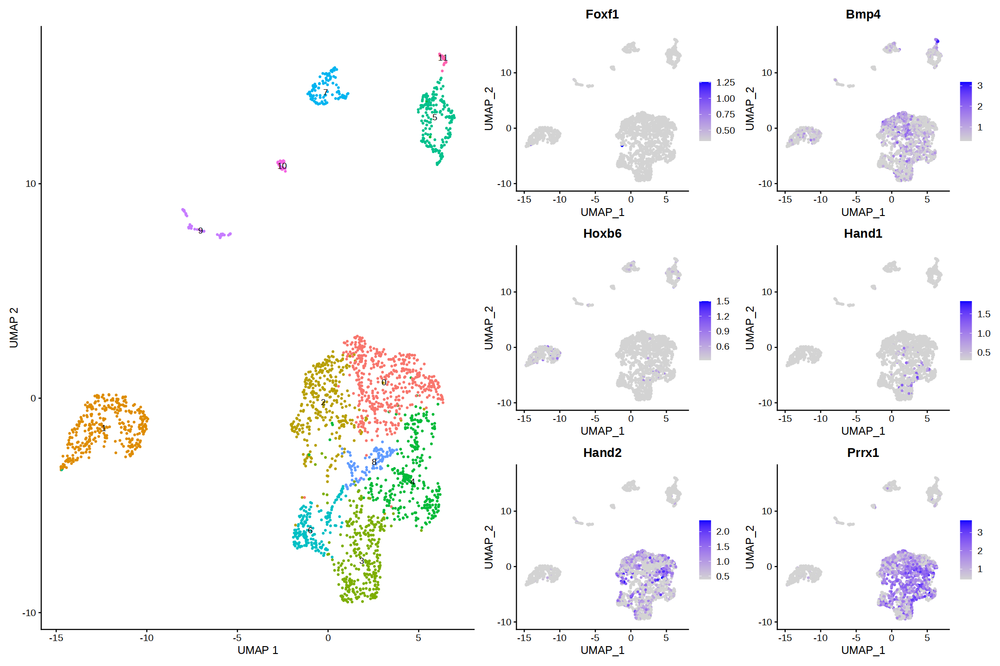

In [14]:
# Lateral plate mesoderm
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Foxf1", "Bmp4", "Hoxb6", "Hand1", "Hand2", "Gata4","Prrx1"), min.cutoff = "q1")  

p1 + p2

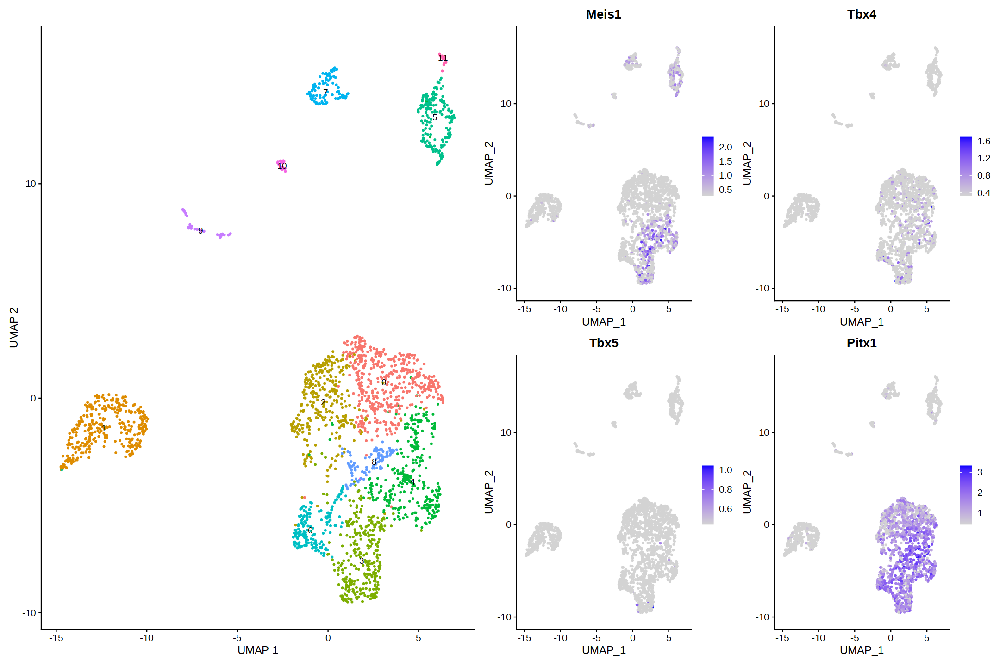

In [15]:
# Early limb bud mesenchyme
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Meis1", "Tbx4", "Tbx5",'Pitx1'), min.cutoff = "q1")  

p1 + p2

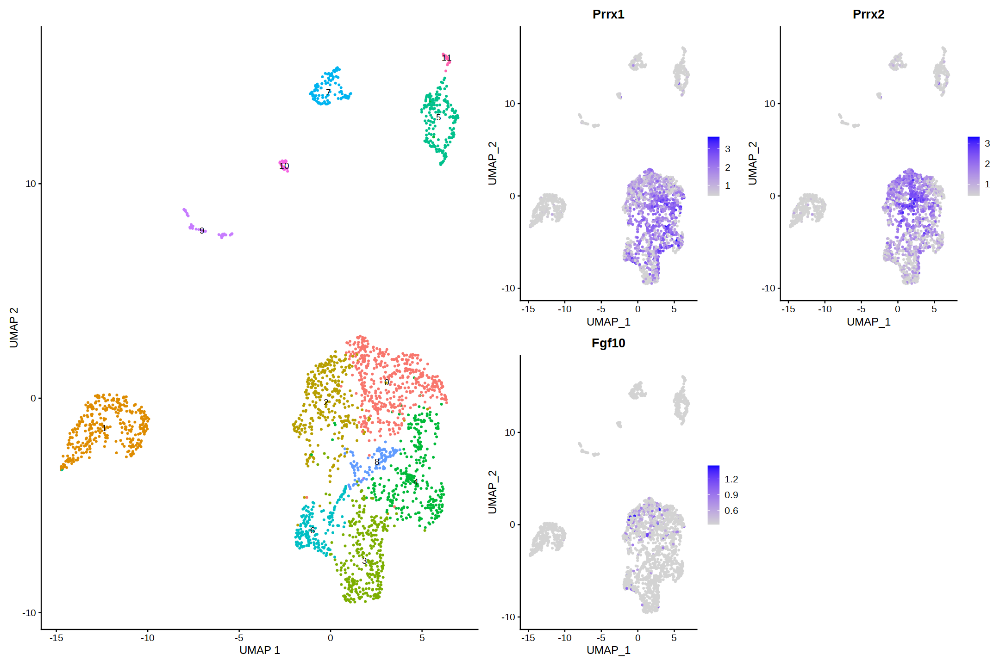

In [16]:
# limb bud mesenchyme
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prrx1", "Prrx2", "Fgf10"), min.cutoff = "q1")  

p1 + p2

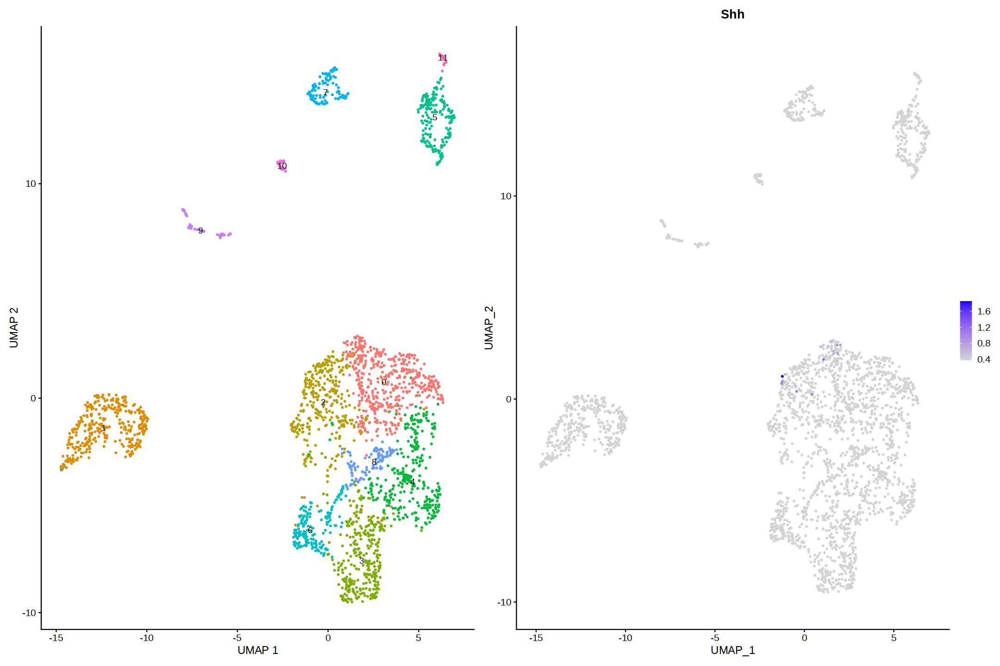

In [17]:
# ZPA
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Shh"), min.cutoff = "q1")  

p1 + p2

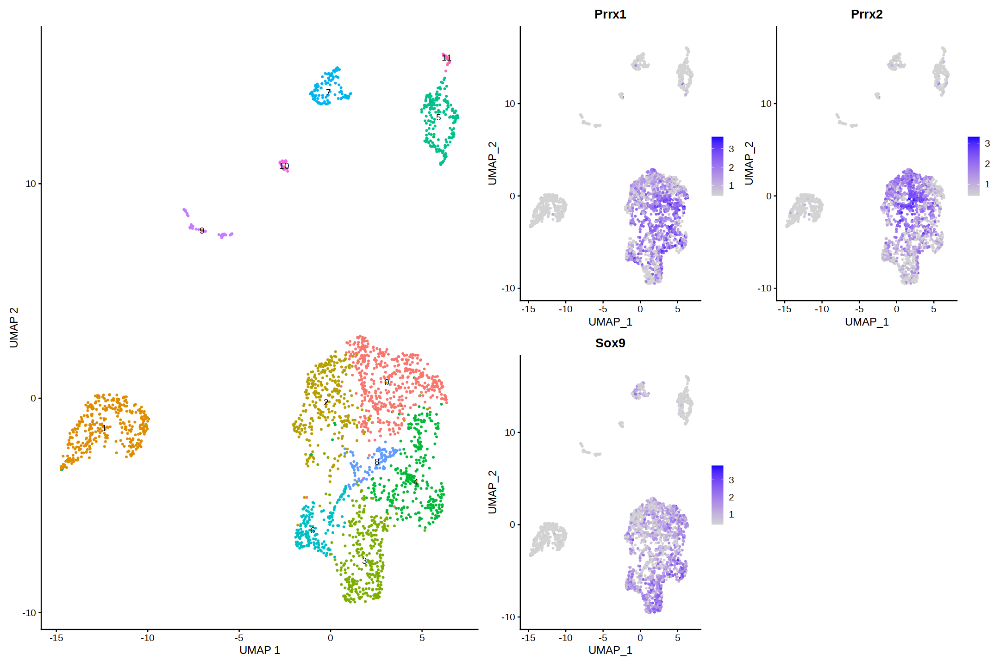

In [18]:
# Chondroprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prrx1", "Prrx2", "Sox9"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Prg4”


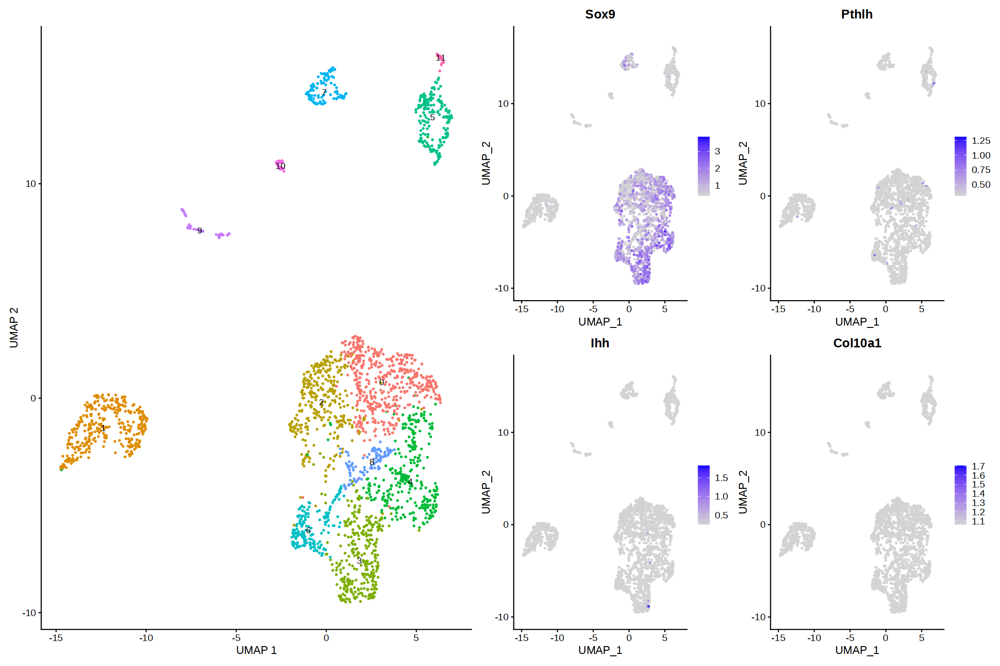

In [19]:
# Chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Prg4","Sox9","Pthlh","Ihh","Col10a1"), min.cutoff = "q1")  

p1 + p2

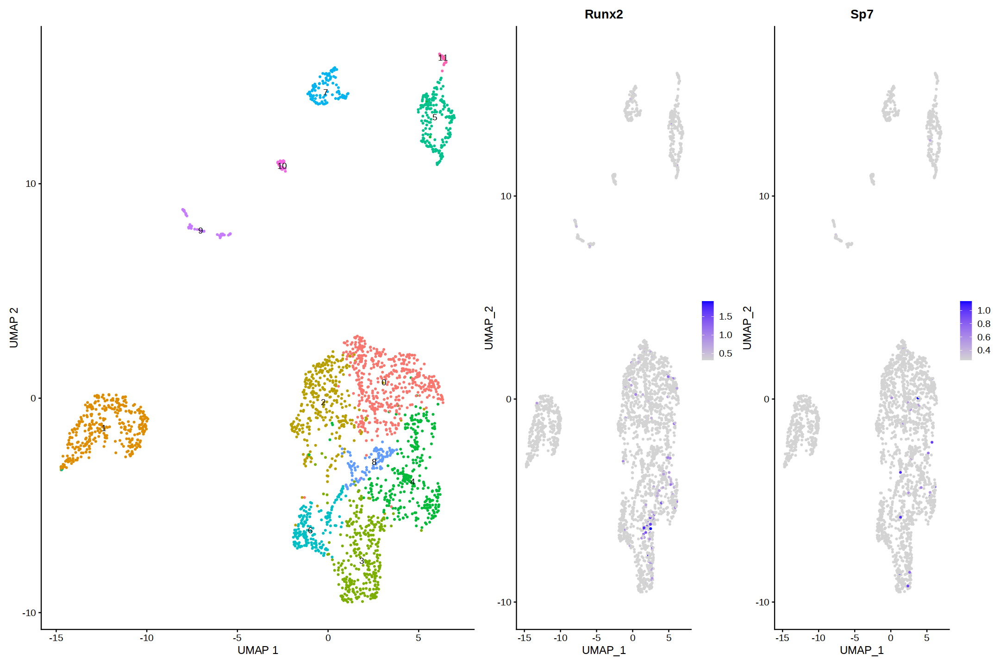

In [20]:
# Osteoprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Runx2", "Sp7"), min.cutoff = "q1")  

p1 + p2

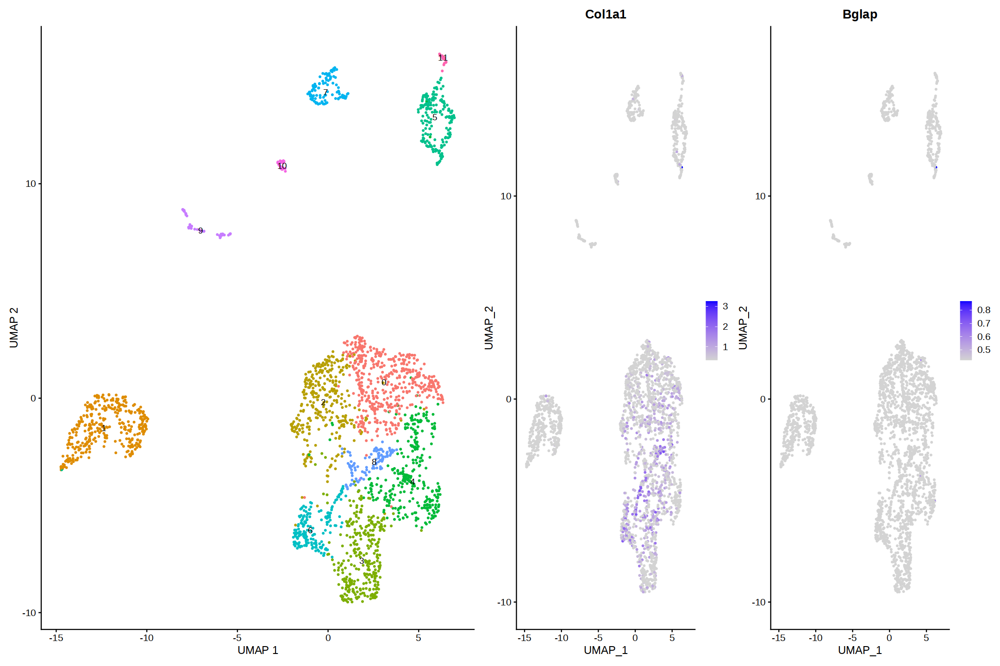

In [21]:
# Osteoblasts
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col1a1", "Bglap"), min.cutoff = "q1")  

p1 + p2

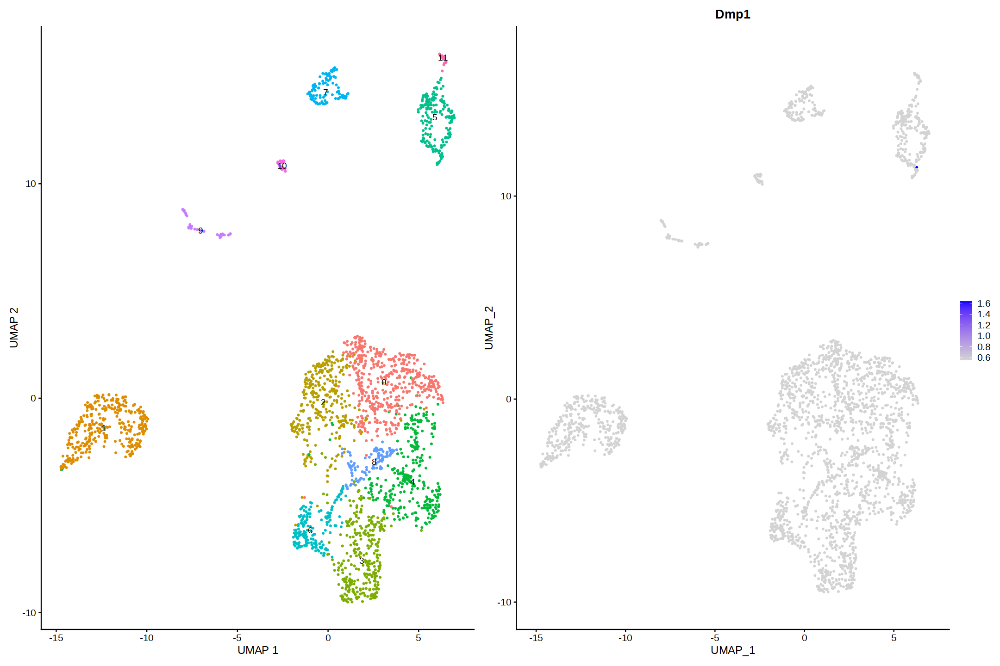

In [22]:
# Osteocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Dmp1"), min.cutoff = "q1")  

p1 + p2

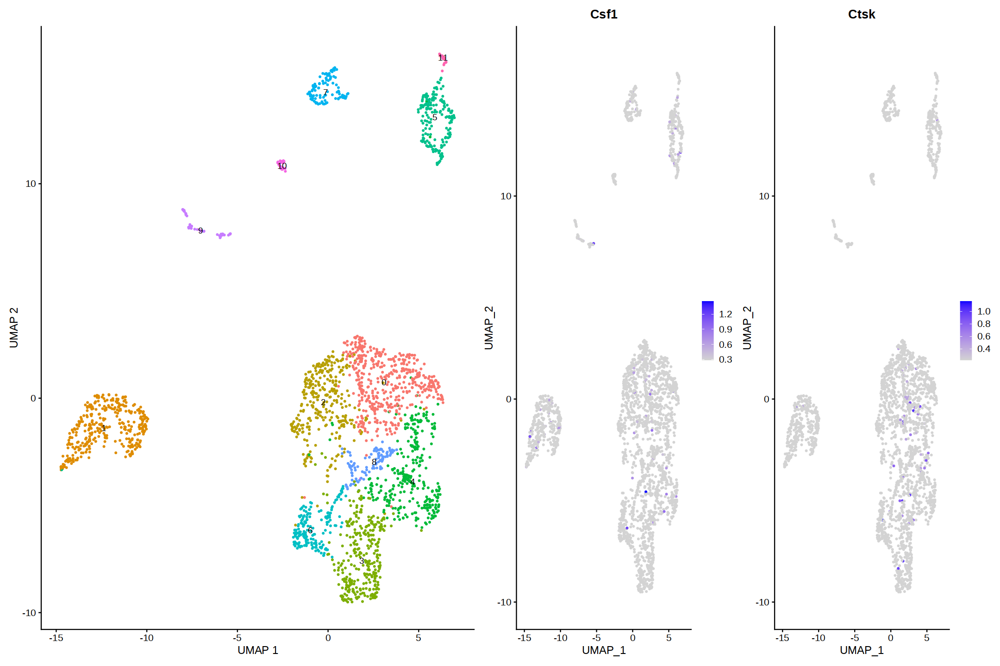

In [23]:
# Osteoclasts
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Csf1", "Ctsk"), min.cutoff = "q1")  

p1 + p2

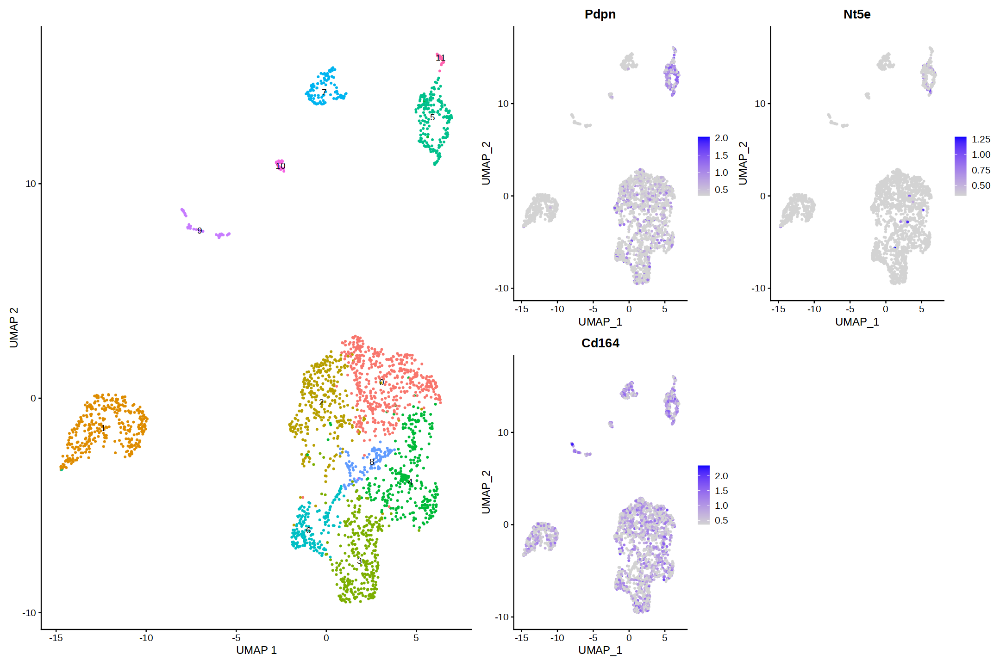

In [24]:
# Periosteal stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pdpn", "Nt5e", "Cd164"), min.cutoff = "q1")  

p1 + p2

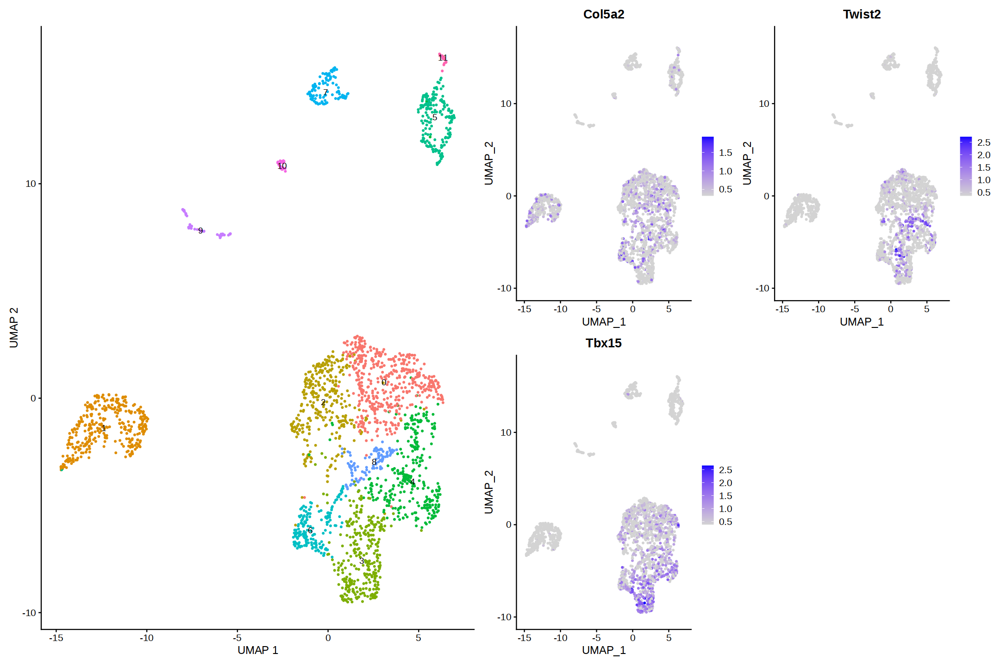

In [25]:
# Periosteal progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col5a2", "Twist2", "Tbx15"), min.cutoff = "q1")  

p1 + p2

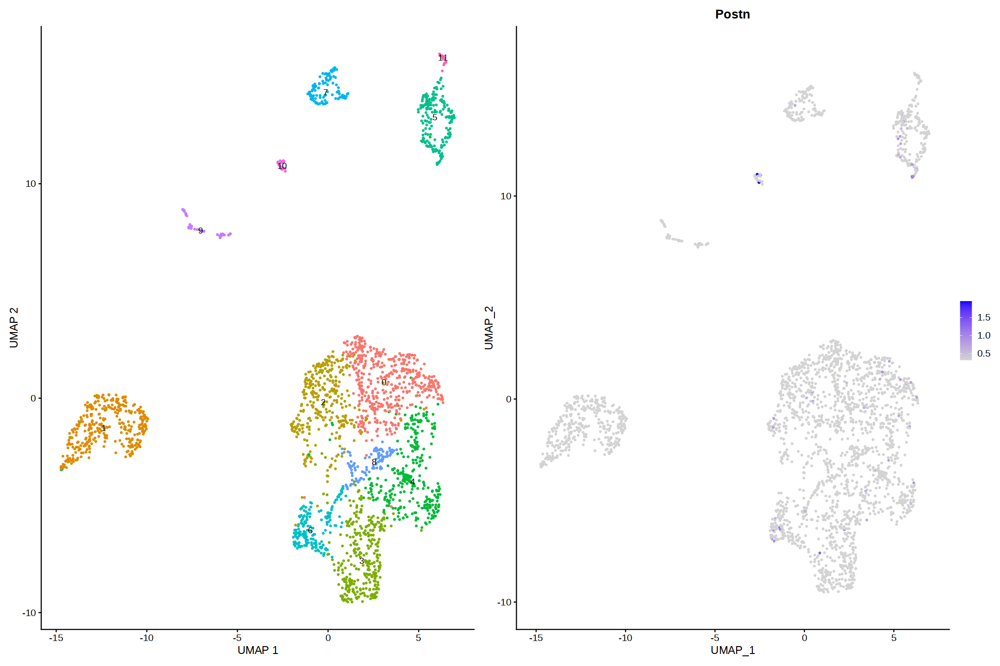

In [26]:
# Periosteum
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Postn"), min.cutoff = "q1")  

p1 + p2

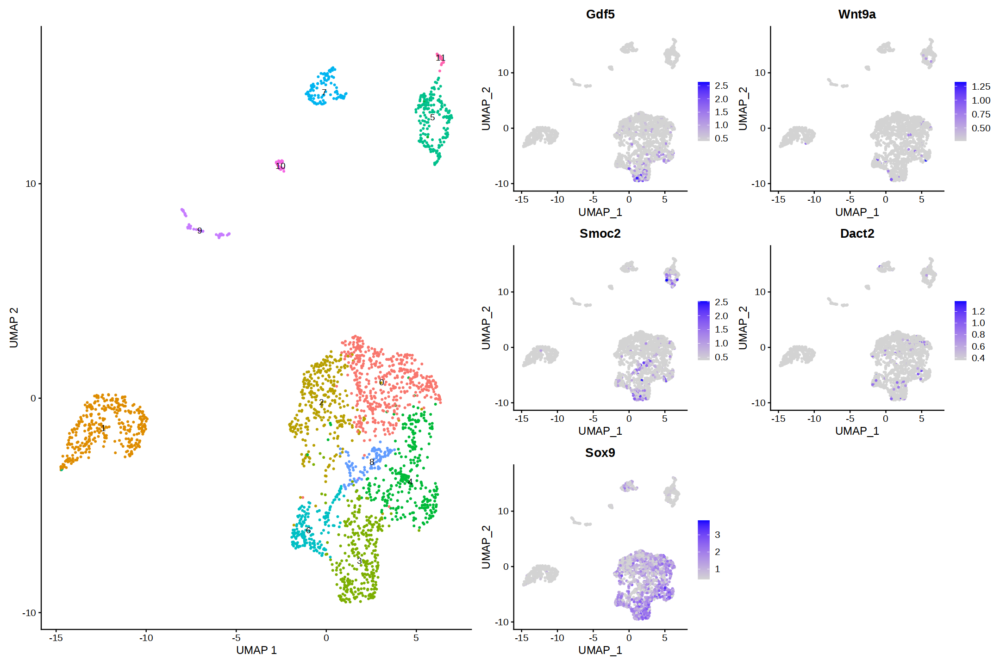

In [27]:
# Joint precursors: sox9-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Gdf5", "Wnt9a", "Smoc2", "Dact2","Sox9"), min.cutoff = "q1")  

p1 + p2

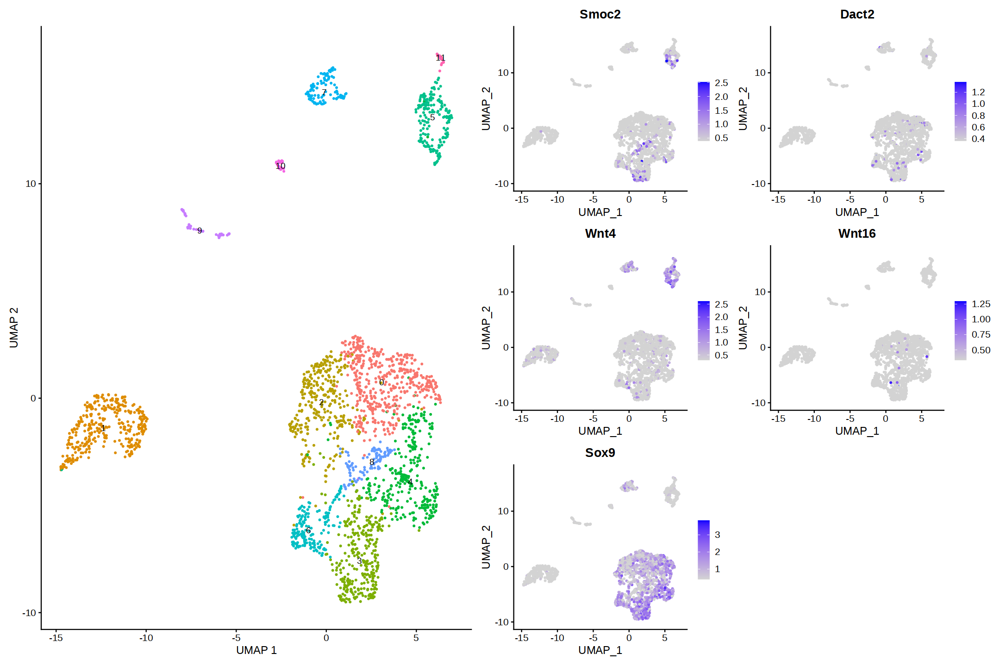

In [28]:
# Interzone cells: sox9-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Smoc2", "Dact2", "Wnt4", "Wnt16","Sox9"), min.cutoff = "q1")  

p1 + p2

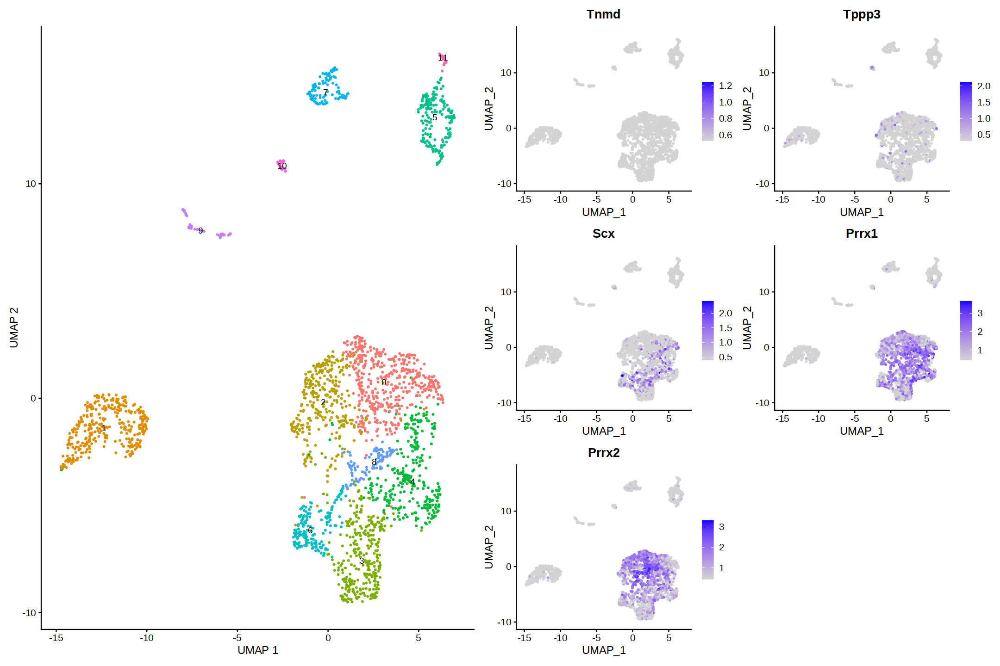

In [30]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

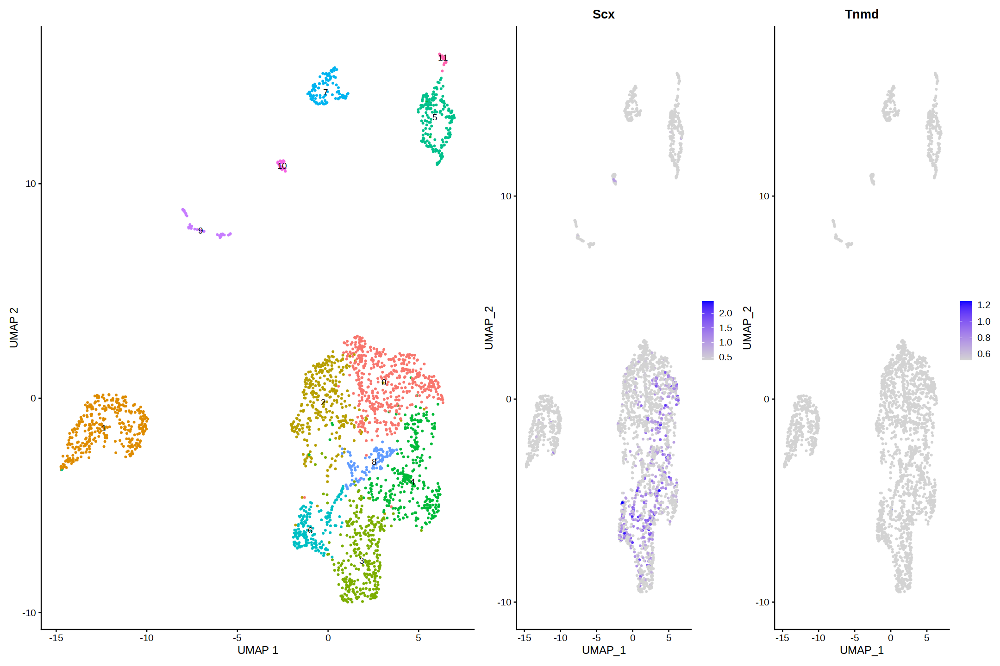

In [31]:
# Tenocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Scx", "Tnmd"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Dra, Hla”


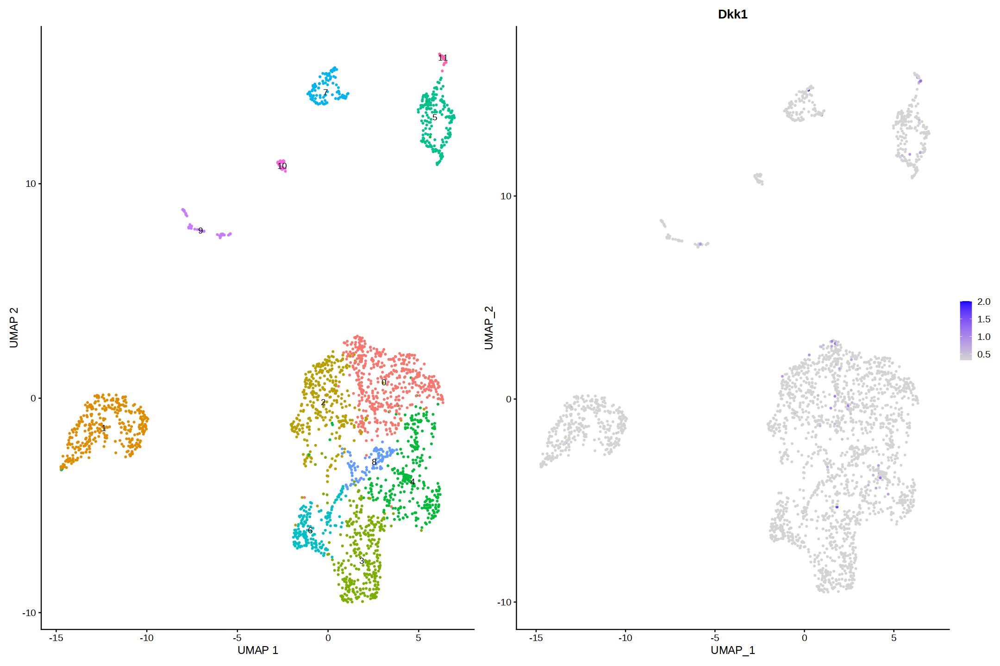

In [32]:
# Synovial fibroblasts: Hla-
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Dkk1", "Dra","Hla"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Sim1”


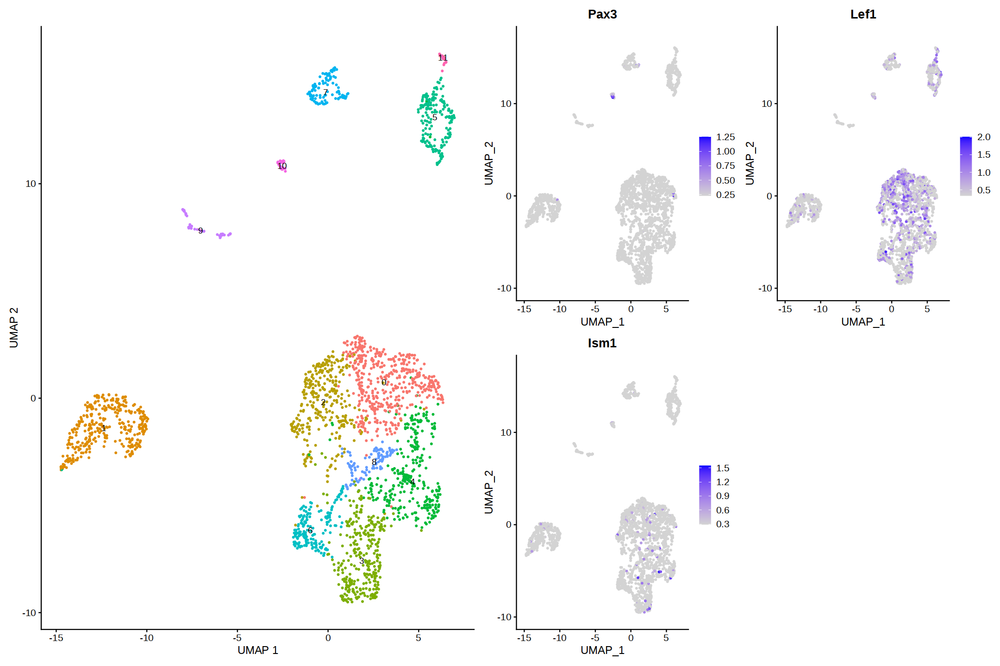

In [33]:
# Dermomyotome
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Sim1", "Pax3", "Lef1", "Ism1"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Myhc, Mrf4”


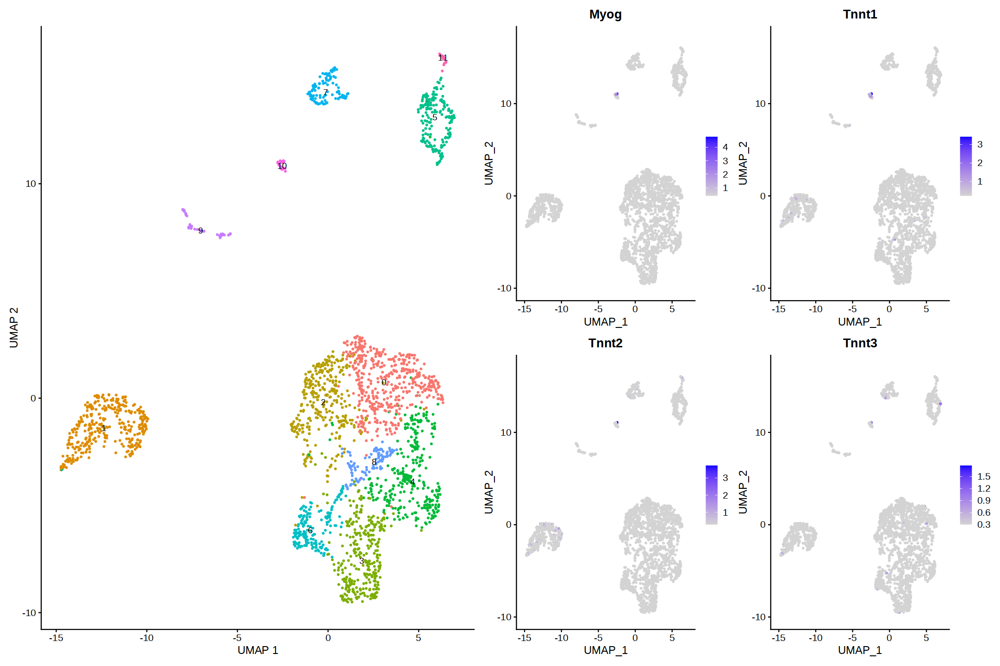

In [34]:
# Skeletal muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Myhc", "Mrf4","Myog",'Tnnt1','Tnnt2','Tnnt3'), min.cutoff = "q1")  

p1 + p2

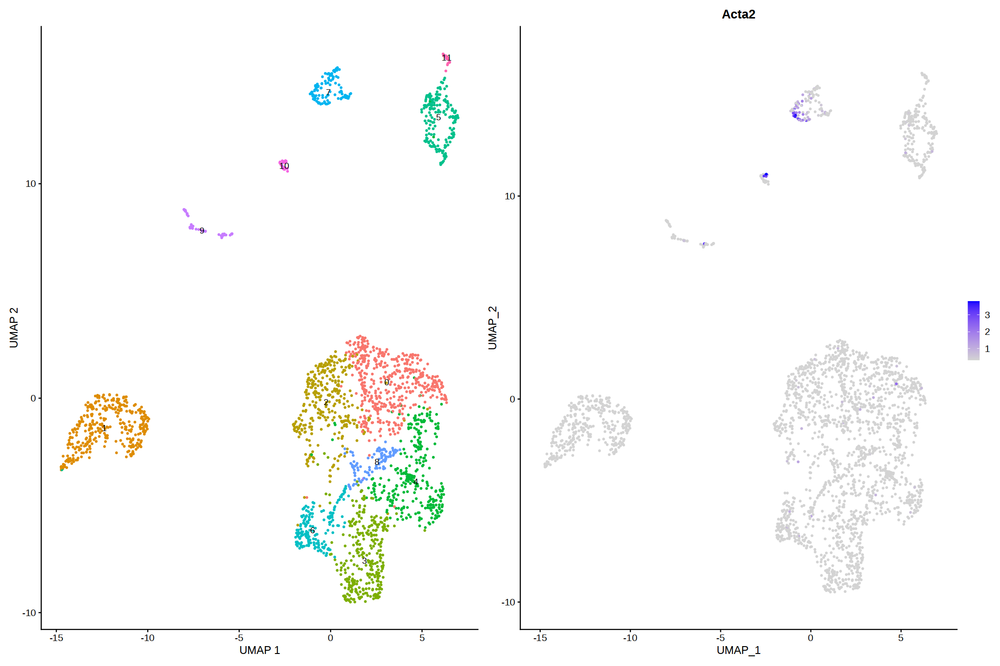

In [35]:
# Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Acta2"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Pax7”


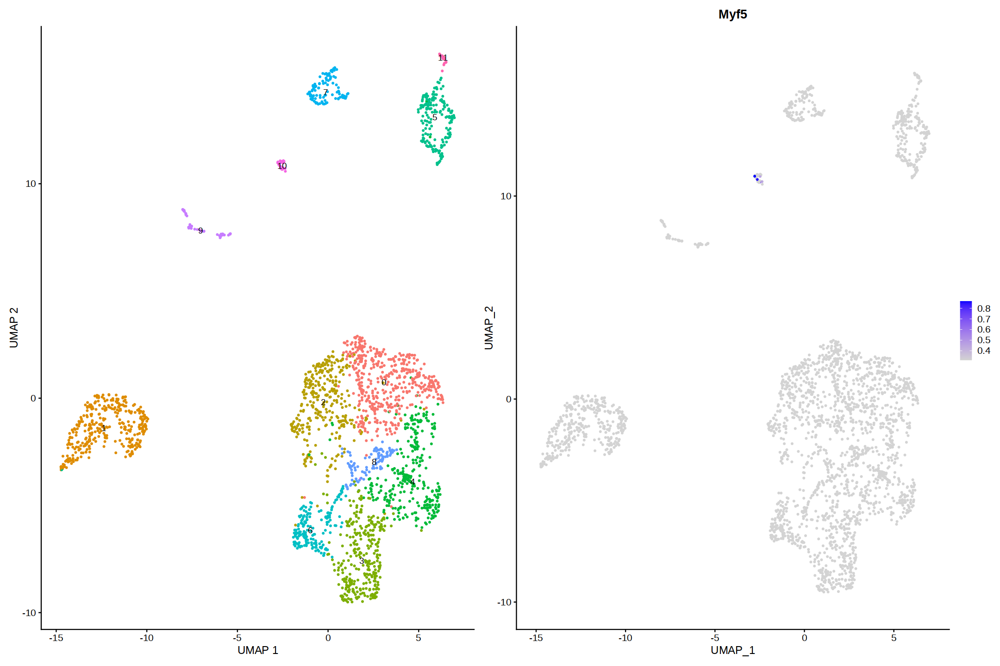

In [36]:
# Myogenic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pax7","Myf5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Pax7, Notch, Myod”


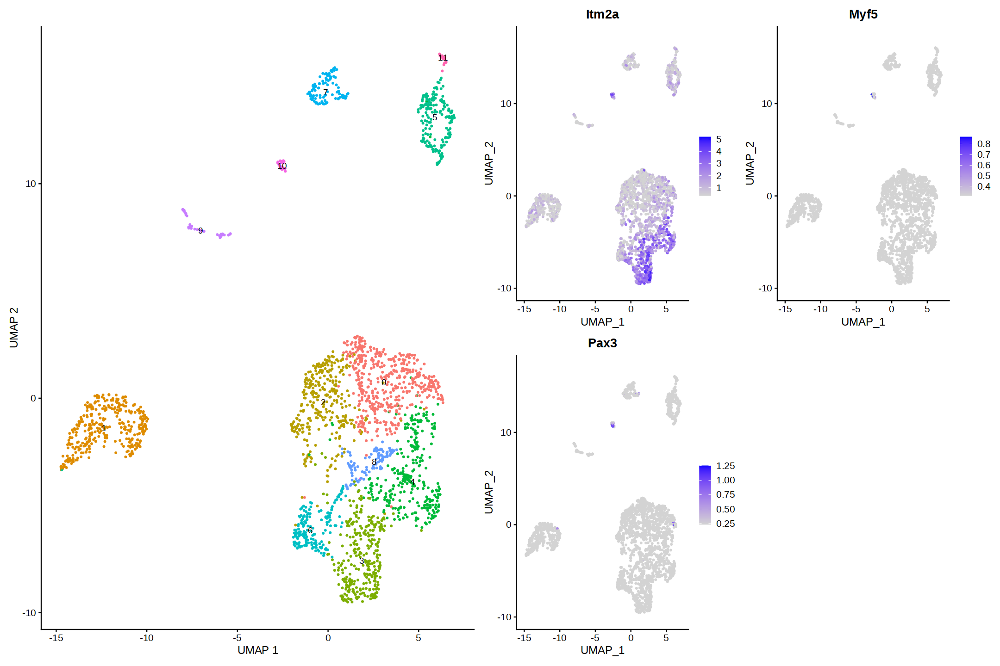

In [37]:
# Muscle progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pax7", "Notch", "Itm2a", "Myf5", "Pax3", "Myod"), min.cutoff = "q1")  

p1 + p2

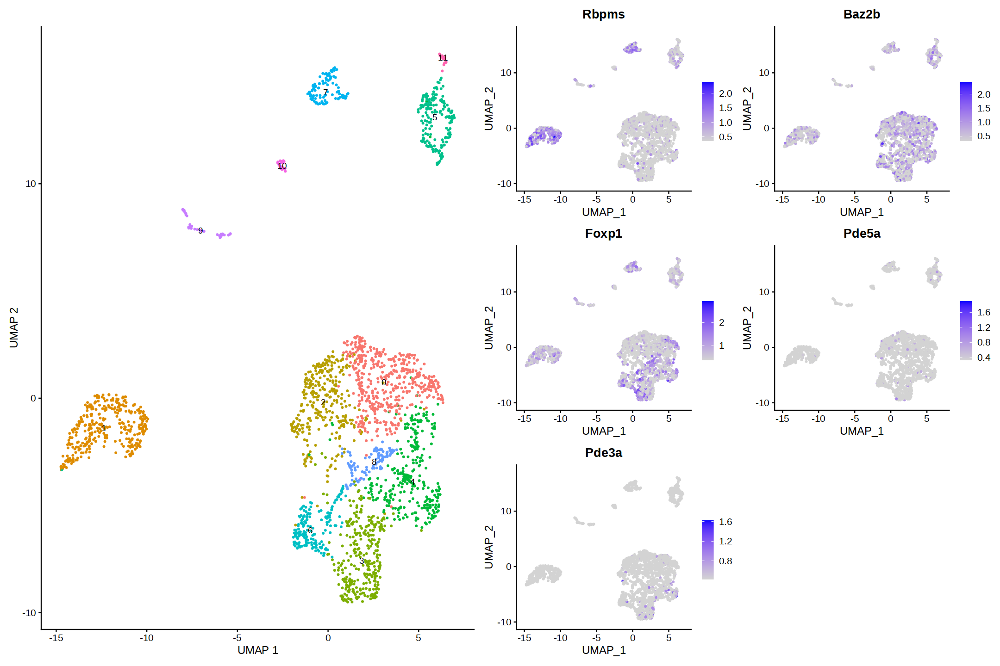

In [38]:
# Cardiomyocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Rbpms", "Baz2b", "Foxp1", "Pde5a", "Pde3a"), min.cutoff = "q1")  

p1 + p2

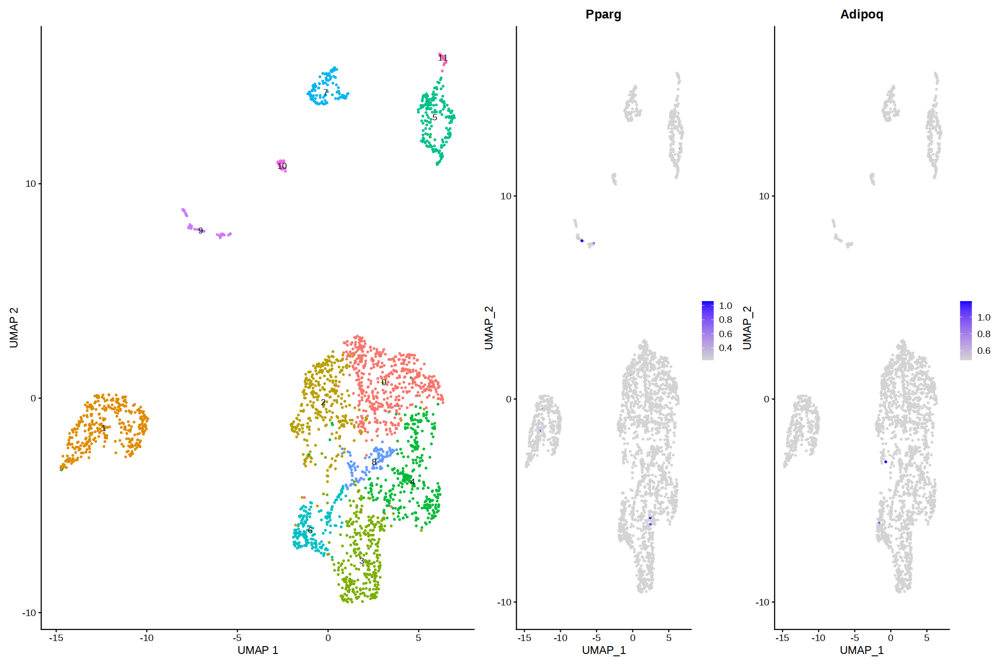

In [39]:
# Adipocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Pparg", "Adipoq"), min.cutoff = "q1")  

p1 + p2

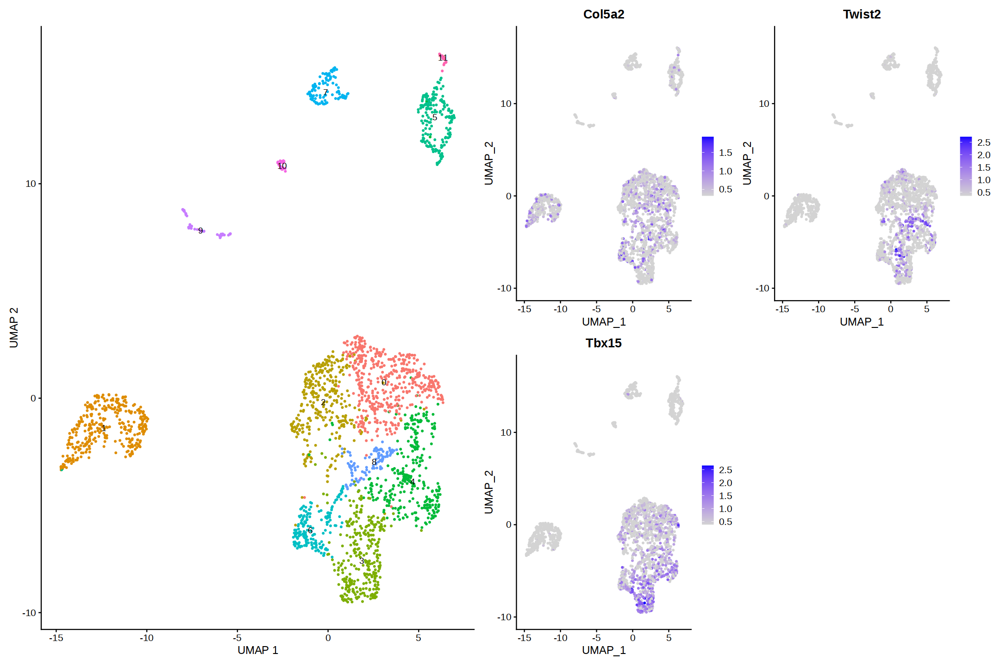

In [41]:
# Perichondrium
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Col5a2", "Twist2", "Tbx15"), min.cutoff = "q1")  

p1 + p2

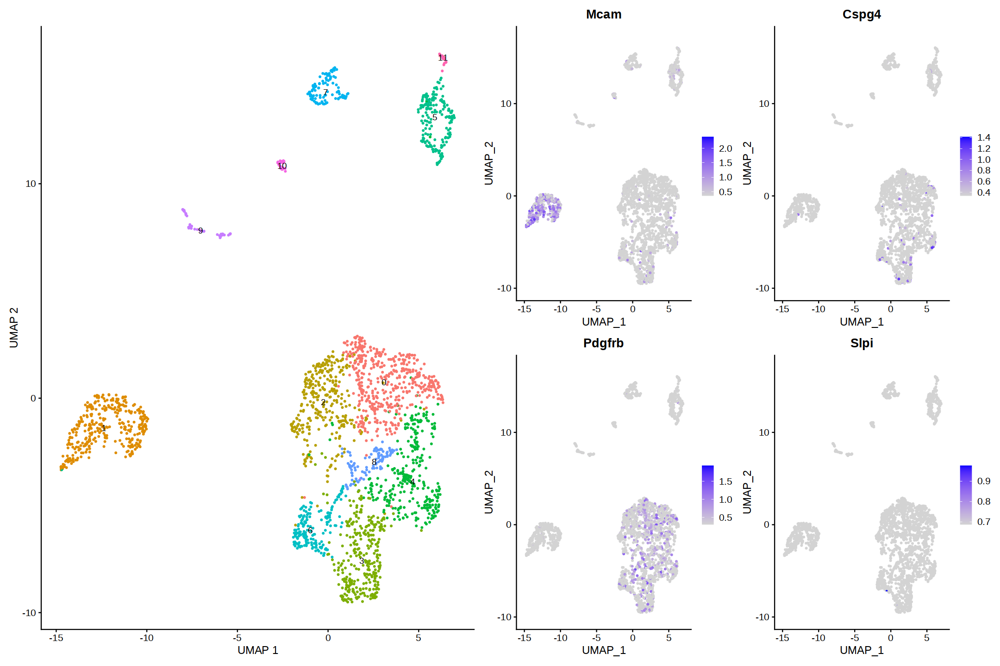

In [42]:
# Pericytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Mcam", "Cspg4", "Pdgfrb", "Slpi"), min.cutoff = "q1")  

p1 + p2

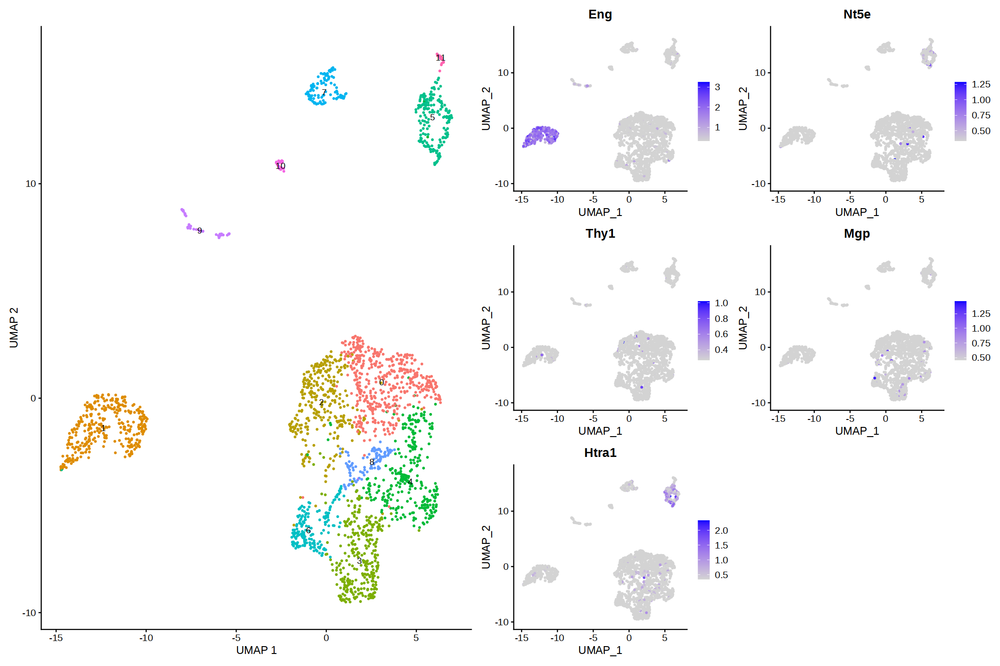

In [44]:
# BMSC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Eng", "Nt5e", "Thy1", "Mgp","Htra1"), min.cutoff = "q1")  

p1 + p2

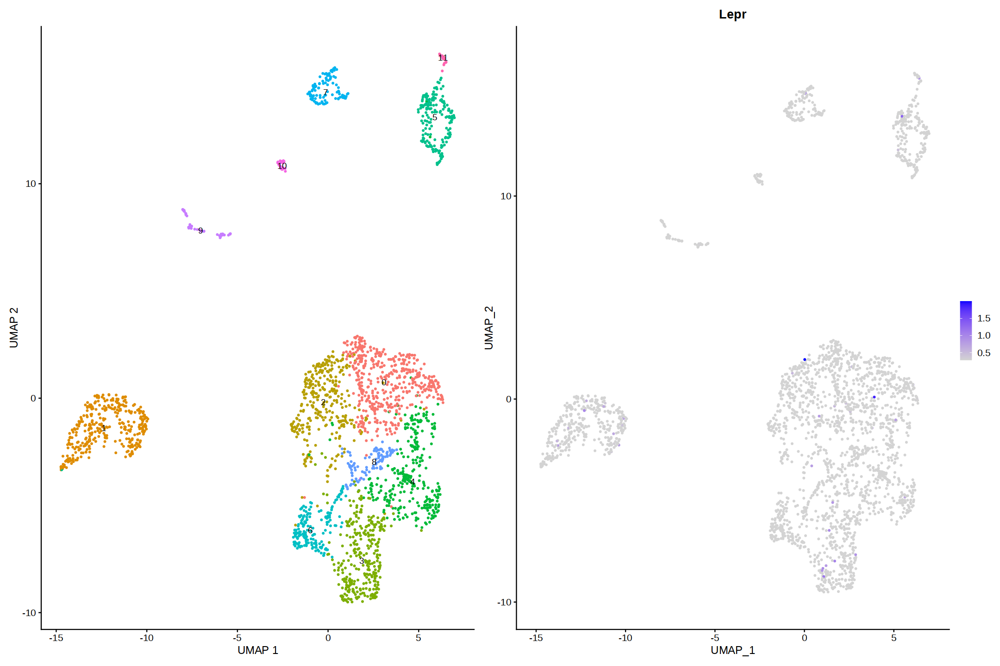

In [45]:
# LepR+ BMSC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Lepr"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Sca1”


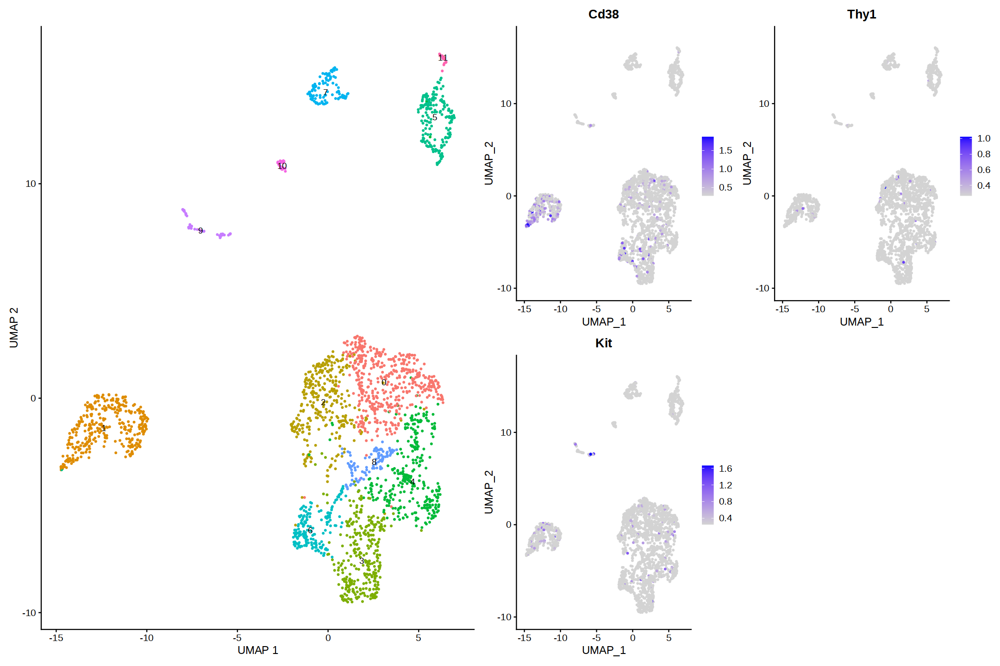

In [46]:
# Hematopoetic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cd38", "Thy1", "Kit", "Sca1"), min.cutoff = "q1")  

p1 + p2

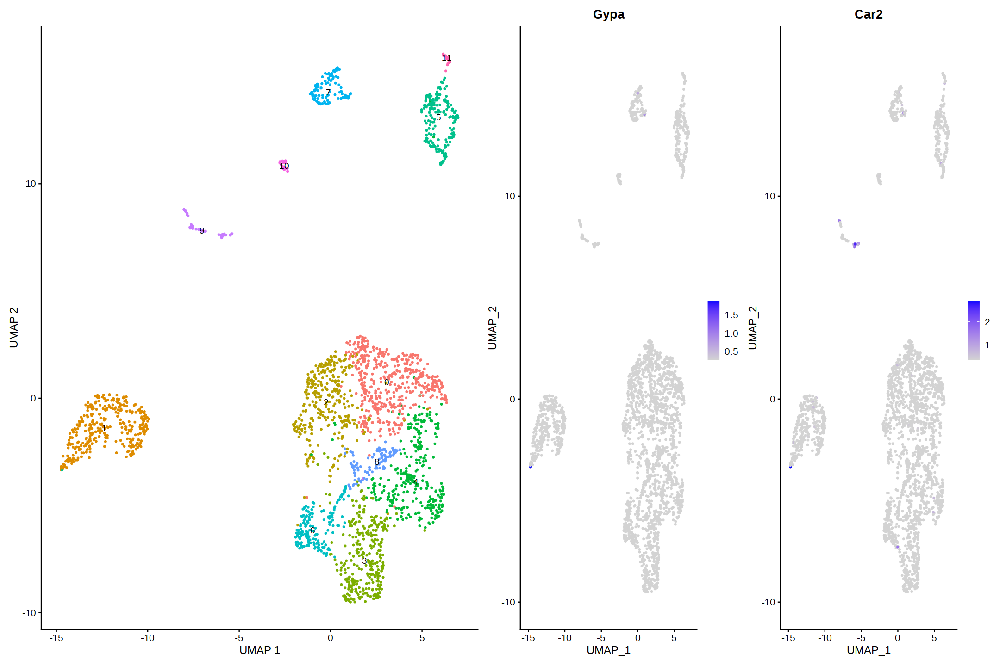

In [47]:
# Erythroid cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Gypa","Car2",""), min.cutoff = "q1")  

p1 + p2

In [49]:
# Platelets
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("F2rl2", "F5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: F2rl2, F5”


ERROR: Error: None of the requested features were found: F2rl2, F5 in slot data


Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Gp6, Gp1ba”


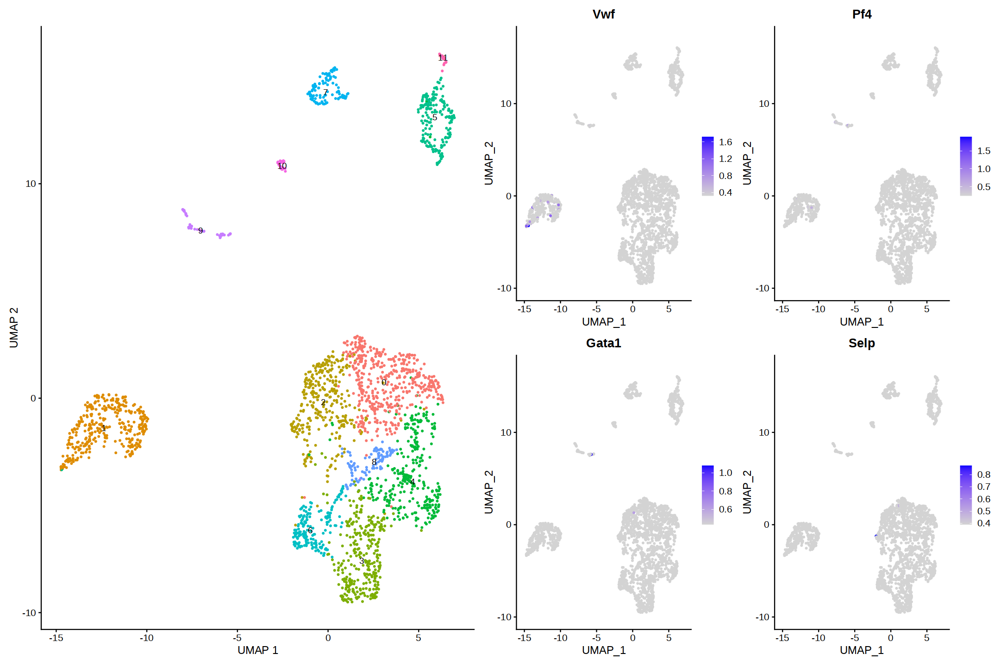

In [50]:
# Megakaryocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Vwf", "Pf4", "Gata1", "Selp", "Gp6", "Gp1ba"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Cd19”


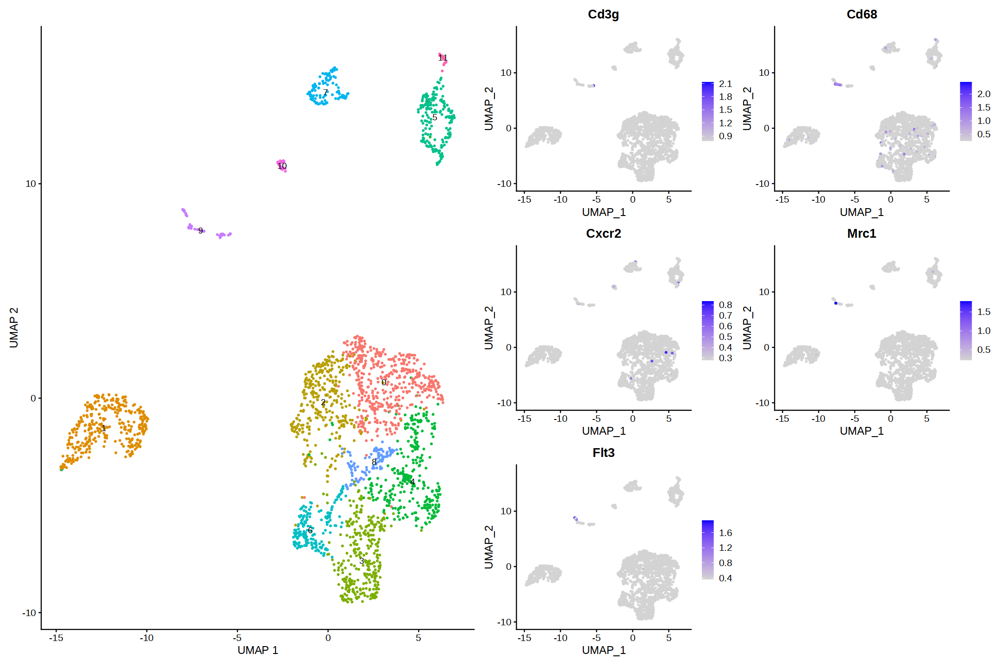

In [51]:
# Immune cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cd3g", "Cd19", "Cd68", "Cxcr2","Mrc1","Flt3"), min.cutoff = "q1")  

p1 + p2

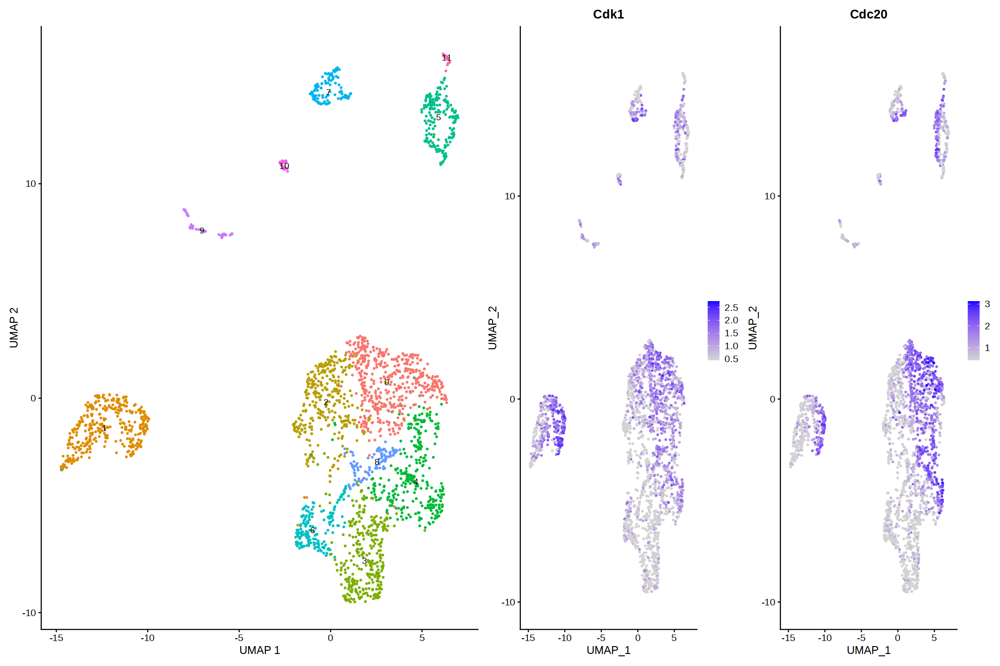

In [52]:
# Fast proliferating cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Cdk1","Cdc20"), min.cutoff = "q1")  

p1 + p2

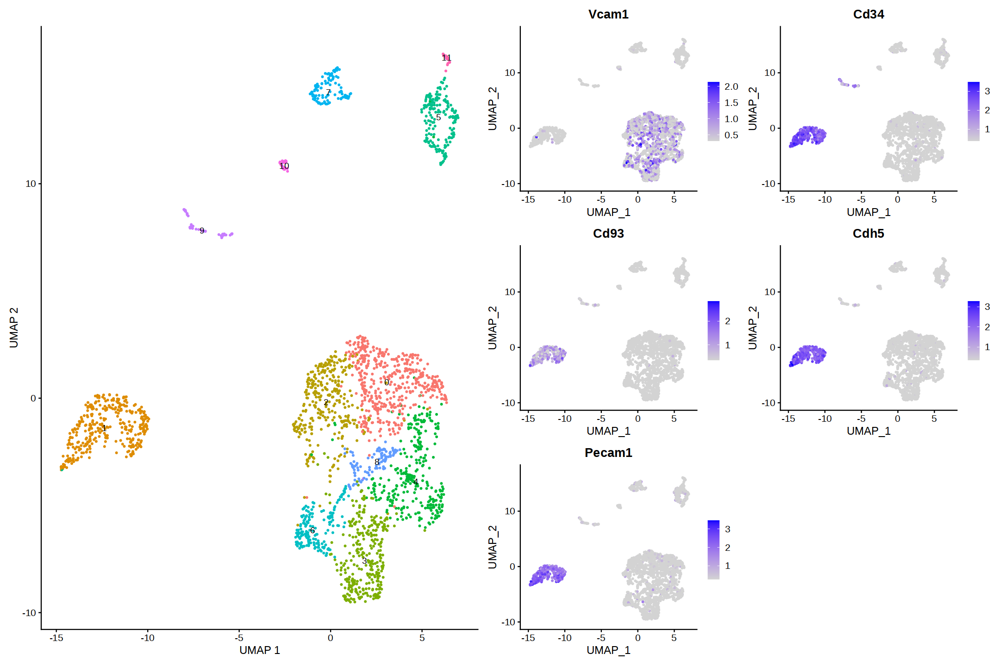

In [53]:
# Vascular endothelial cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Vcam1", "Cd34", "Cd93", "Cdh5","Pecam1"), min.cutoff = "q1")  

p1 + p2

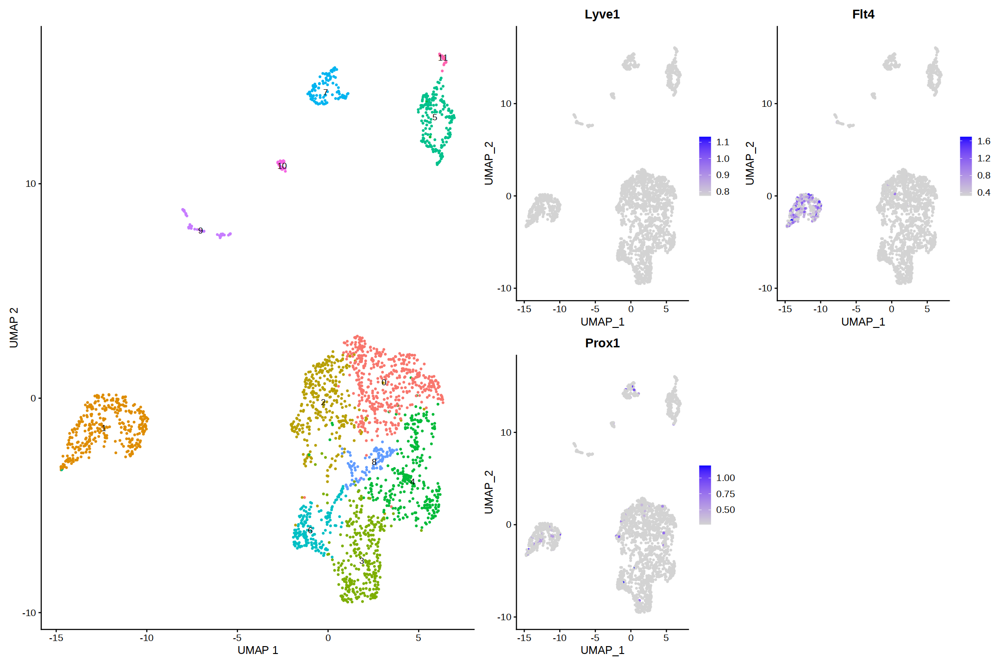

In [54]:
# Lymphatic endothelial cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Lyve1", "Flt4", "Prox1"), min.cutoff = "q1")  

p1 + p2

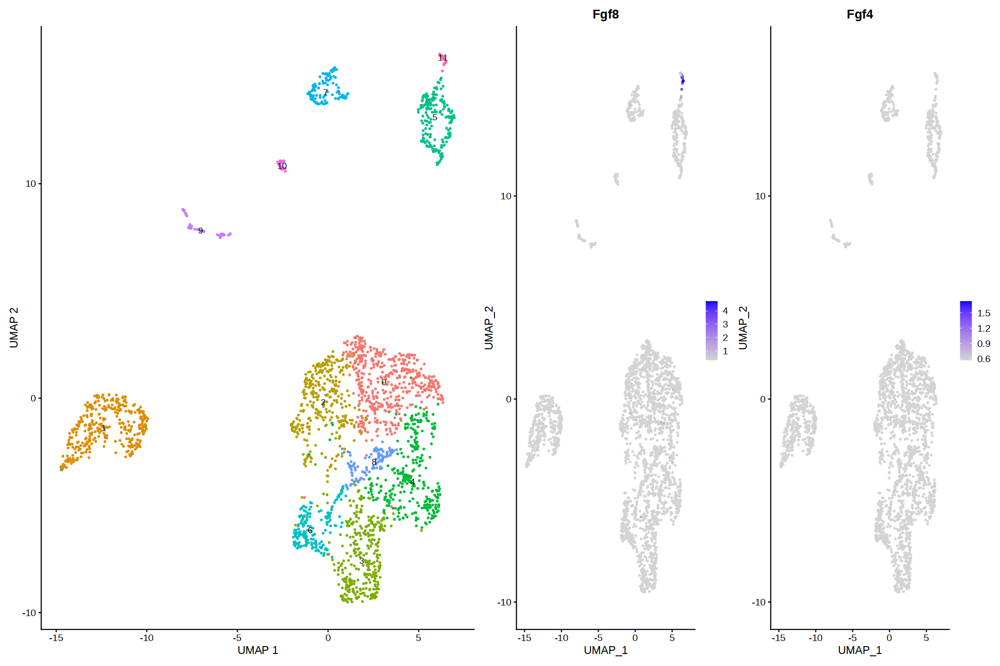

In [55]:
# Apical ectodermal ridge
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Fgf8", "Fgf4"), min.cutoff = "q1")  

p1 + p2

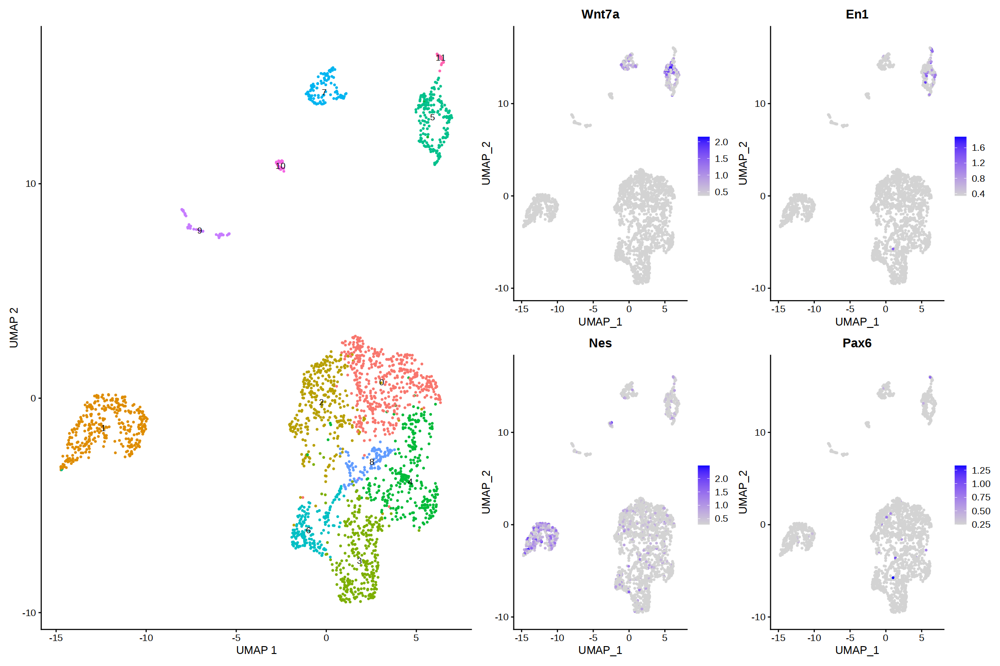

In [56]:
# Ectoderm
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Wnt7a", "En1", "Nes", "Pax6"), min.cutoff = "q1")  

p1 + p2

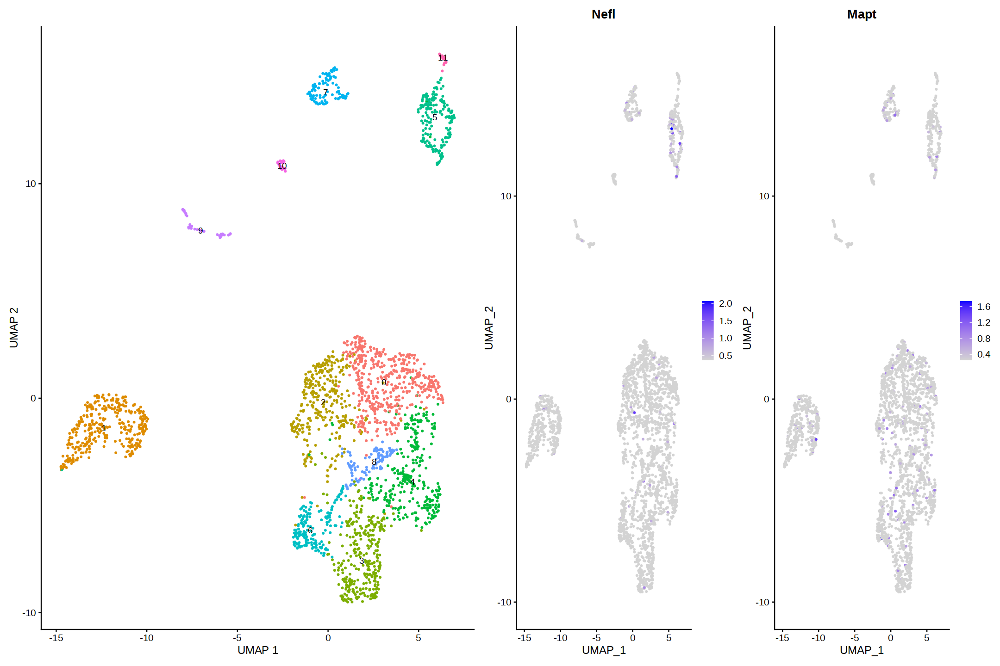

In [57]:
# Neurons
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Nefl", "Mapt"), min.cutoff = "q1")  

p1 + p2

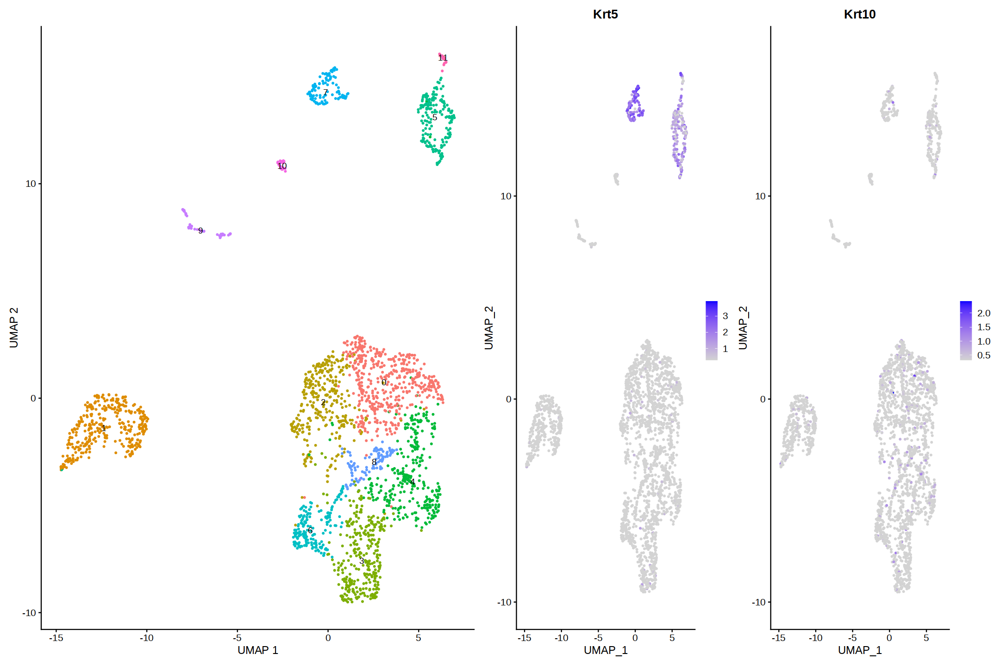

In [58]:
# Skin
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A, c("Krt5", "Krt10"), min.cutoff = "q1")  

p1 + p2

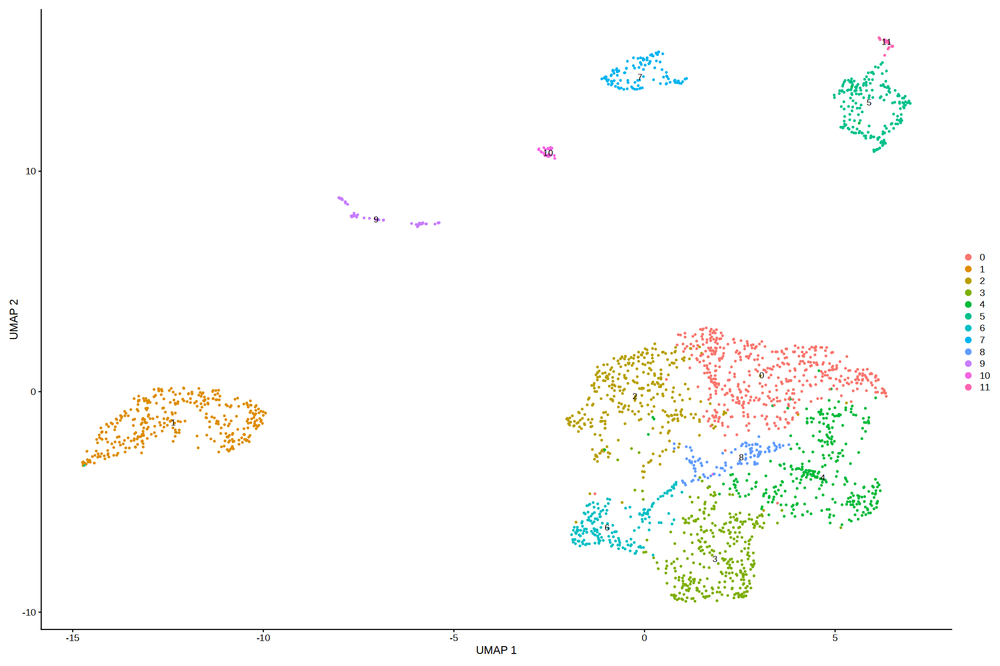

In [59]:
DimPlot(A, label = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

### 3.4. Differential expression analysis<a id="12"></a>
#### 3.4.1. Global annotation by differential expression analysis<a id="13"></a>

Seurat identifies markers that define clusters via differential expression. By default, it identifes positive and negative markers of a single cluster (specified in ident.1), compared to all other cells. `FindAllMarkers` automates this process for all clusters, but it is possible to test groups of clusters vs. each other, or against all cells.

The `min.pct` argument requires a feature to be detected at a minimum percentage in either of the two groups of cells, and the `thresh.test` argument requires a feature to be differentially expressed (on average) by some amount between the two groups. You can set both of these to 0, but with a dramatic increase in time - since this will test a large number of features that are unlikely to be highly discriminatory. As another option to speed up these computations, `max.cells.per.ident` can be set. This will downsample each identity class to have no more cells than whatever this is set to. While there is generally going to be a loss in power, the speed increases can be significiant and the most highly differentially expressed features will likely still rise to the top.

In [60]:
# Seurat default settings
A.markers <- FindAllMarkers(A, only.pos = TRUE, min.pct = 0.25, logfc.threshold = 0.25)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11



In [63]:
#select only cluster 0 and order avg_log2FC from big to small

A.markers[A.markers$cluster == 7,] %>%
slice_max(n = 20, order_by = avg_log2FC)

,p_val,avg_log2FC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
Sfn1,3.722892e-172,4.848173,1.000,0.121,6.331895e-168,7,Sfn
Krt141,7.200561e-136,4.603116,0.938,0.132,1.224671e-131,7,Krt14
Slc2a31,2.335816e-123,4.567282,1.000,0.208,3.972756e-119,7,Slc2a3
Krt8,2.570010e-187,4.244346,0.991,0.101,4.371073e-183,7,Krt8
Tacstd2,6.721961e-299,4.214687,0.991,0.040,1.143271e-294,7,Tacstd2
Cldn41,2.910262e-192,4.213355,1.000,0.099,4.949773e-188,7,Cldn4
Krt181,2.920860e-112,3.762145,0.991,0.231,4.967799e-108,7,Krt18
Krt17,5.484429e-117,3.561044,0.589,0.043,9.327917e-113,7,Krt17
Cldn3,0.000000e+00,3.381487,0.991,0.034,0.000000e+00,7,Cldn3


In [87]:
#dir.create("./6-kmita/analysis")
write.csv(A.markers, file = "A.markers_e12.5.csv", quote = FALSE)

**Adding cell types**

In [199]:
A@meta.data$CellType <- NULL

In [200]:
#creating column that contains cell type 
A@meta.data$CellType <- Idents(A)

In [201]:
A@meta.data$CellType <- as.character(A@meta.data$CellType)

A@meta.data$CellType[A@meta.data$CellType == '0'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '1'] <- 'Vascular endothelial cells'
A@meta.data$CellType[A@meta.data$CellType == '2'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '3'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '4'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '5'] <- 'Ectoderm'
A@meta.data$CellType[A@meta.data$CellType == '6'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '7'] <- 'Embryonic skin'
A@meta.data$CellType[A@meta.data$CellType == '8'] <- 'Mesenchyme'
A@meta.data$CellType[A@meta.data$CellType == '9'] <- 'Imune cells'
A@meta.data$CellType[A@meta.data$CellType == '10'] <- 'Muscle progenitors'
A@meta.data$CellType[A@meta.data$CellType == '11'] <- 'AER'

A@meta.data$CellType <- as.factor(A@meta.data$CellType)

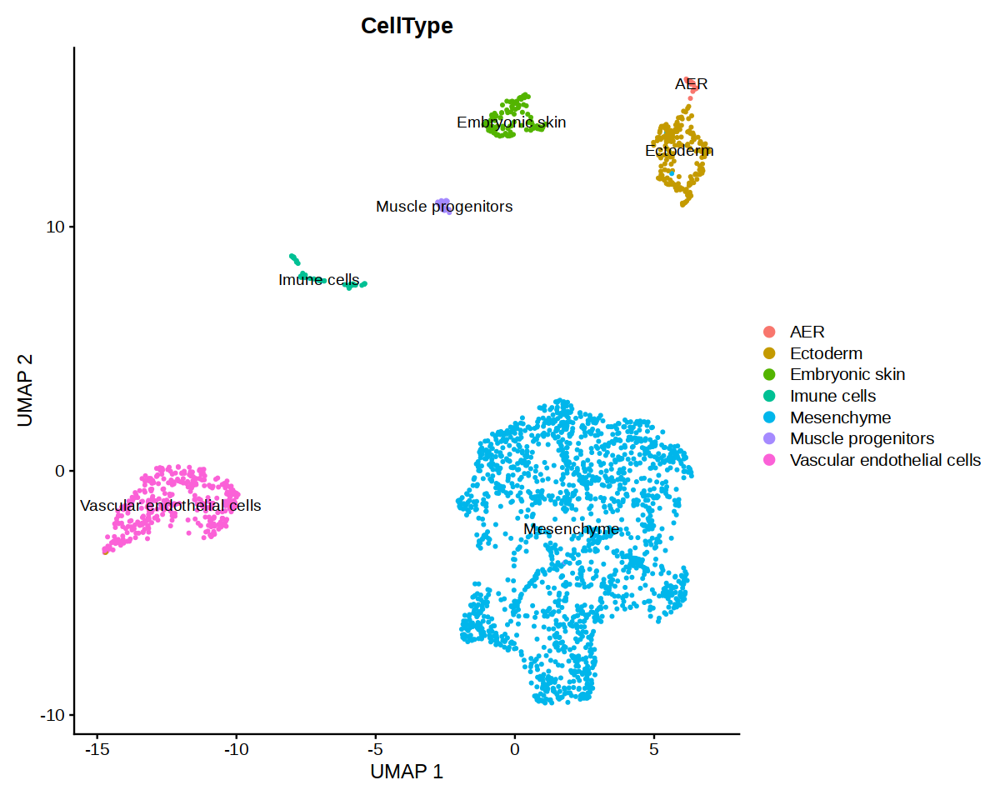

In [202]:
options(repr.plot.width = 10, repr.plot.height = 8)

DimPlot(A, reduction = "umap", label = TRUE, group.by = "CellType") + xlab("UMAP 1") + ylab("UMAP 2")

In [73]:
Idents(A)<-A@meta.data$CellType

#### 3.4.2. Refinement of global annotations<a id="13.2"></a>
##### 3.4.2.1. Subsetting mesenchymal clusters<a id="14"></a>

In [74]:
A_chondrocytes <- subset(A, idents = c("Mesenchyme"))

In [75]:
A_chondrocytes

An object of class Seurat 
17008 features across 1703 samples within 1 assay 
Active assay: RNA (17008 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [76]:
A_chondrocytes <- ScaleData(A_chondrocytes)

Centering and scaling data matrix



In [77]:
A_chondrocytes <- RunPCA(A_chondrocytes, features = VariableFeatures(object = A_chondrocytes), verbose = FALSE)

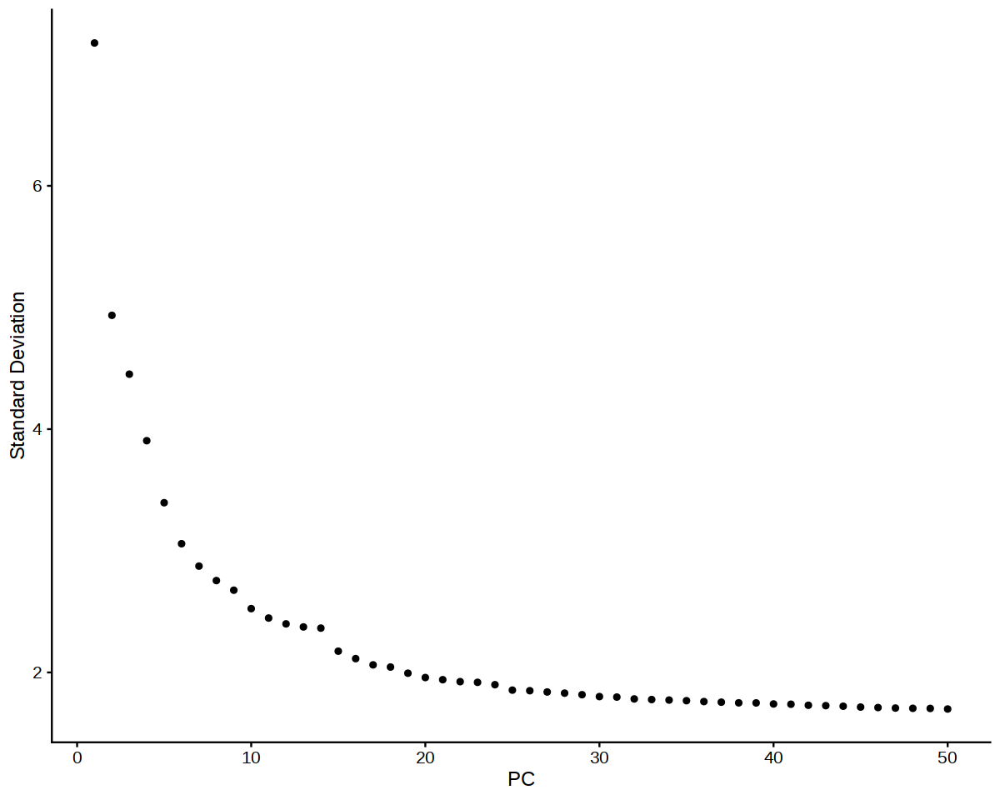

In [78]:
ElbowPlot(A_chondrocytes, 50)

In [79]:
A_chondrocytes <- FindNeighbors(A_chondrocytes, dims = 1:25, verbose = FALSE)
A_chondrocytes <- FindClusters(A_chondrocytes, resolution = 0.8, verbose = FALSE)

In [80]:
A_chondrocytes <- RunUMAP(A_chondrocytes, dims = 1:25, n.neighbors = 12, verbose = FALSE)

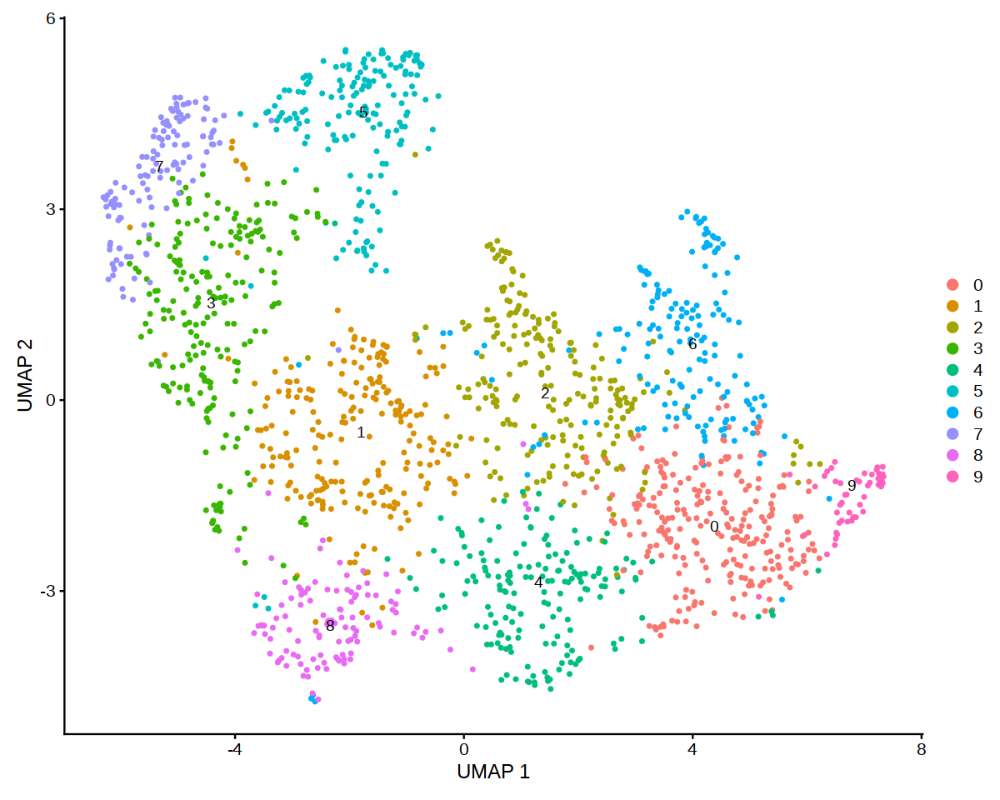

In [81]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_chondrocytes, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [101]:
A_chondrocytes_markers <- FindAllMarkers(A_chondrocytes)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5



In [102]:
write.csv(A_chondrocytes_markers, file = "A_chondrocytes.markers_e12.5.csv", quote = FALSE)

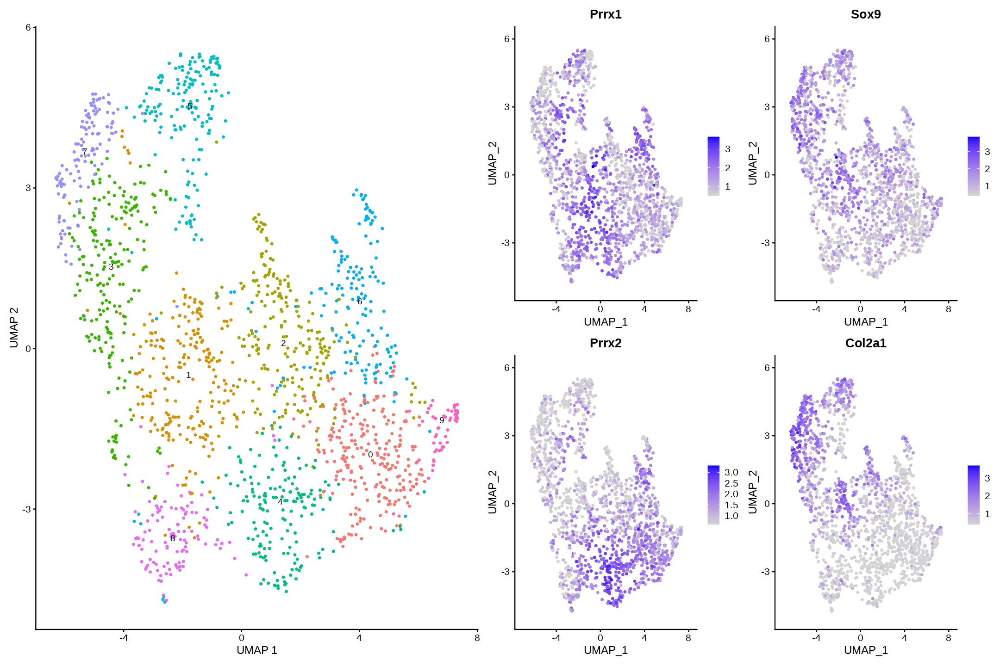

In [91]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prrx1", "Sox9","Prrx2","Col2a1"), min.cutoff = "q1")  

p1 + p2

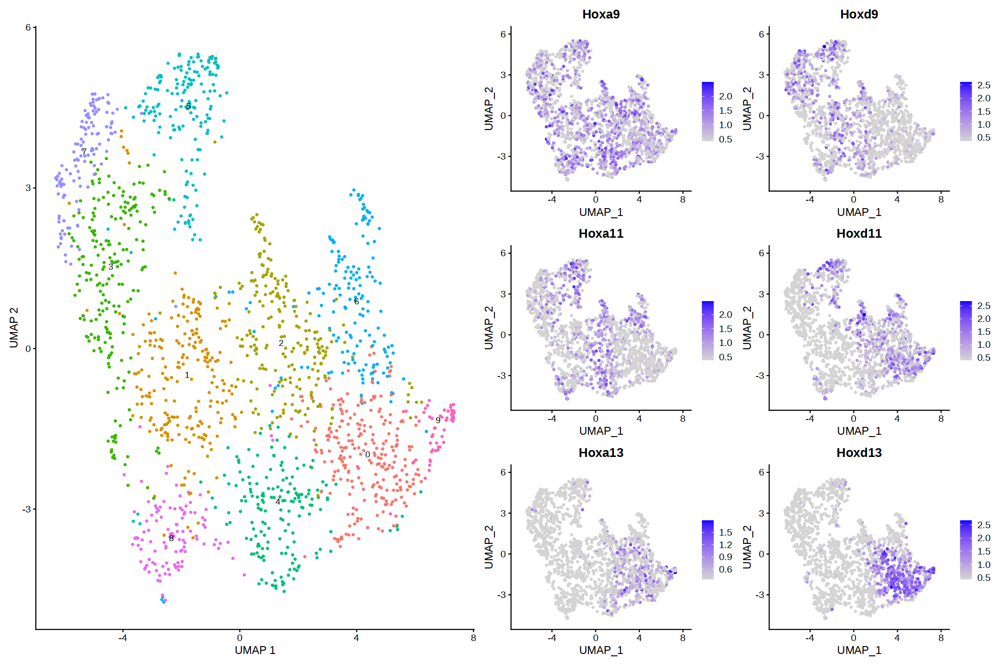

In [92]:
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Hoxa9", "Hoxd9","Hoxa11","Hoxd11","Hoxa13","Hoxd13"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Prg4”


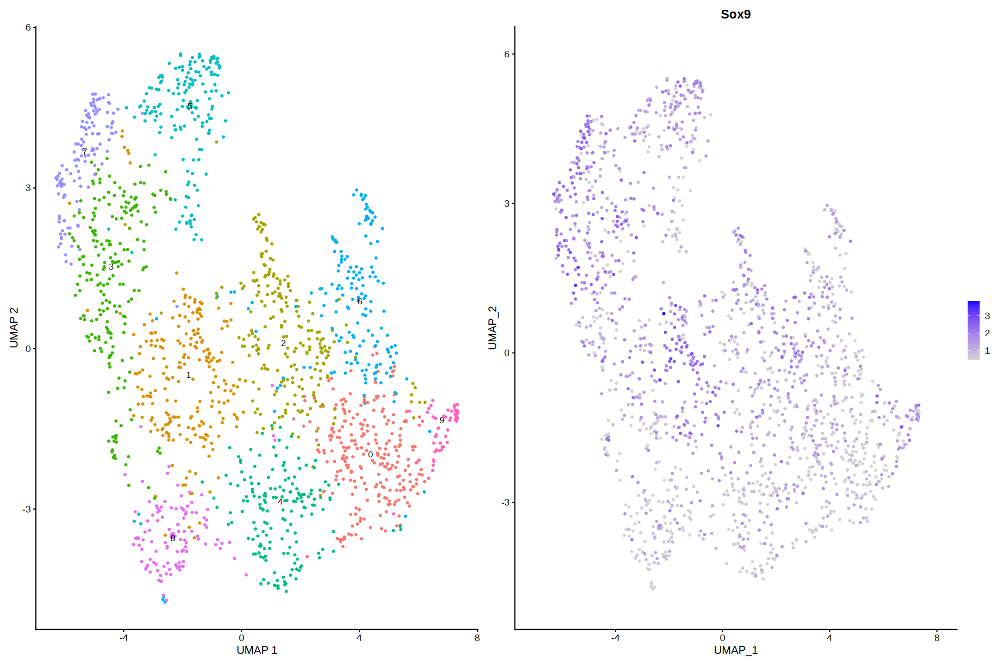

In [82]:
# Articular chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prg4", "Sox9"), min.cutoff = "q1")  

p1 + p2

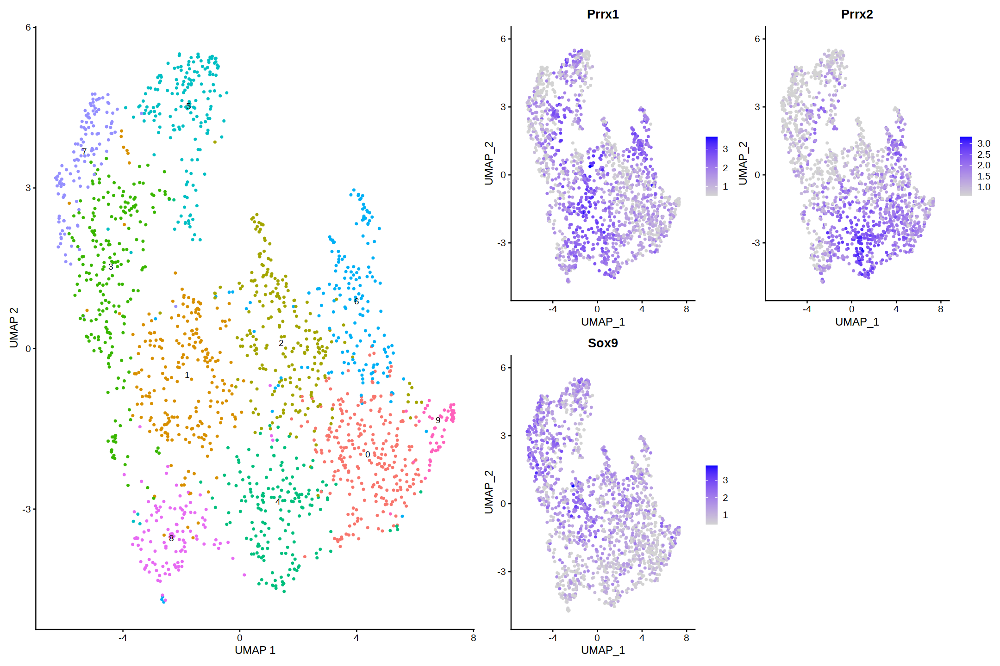

In [83]:
# Chondroprogenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Prrx1", "Prrx2", "Sox9"), min.cutoff = "q1")  

p1 + p2

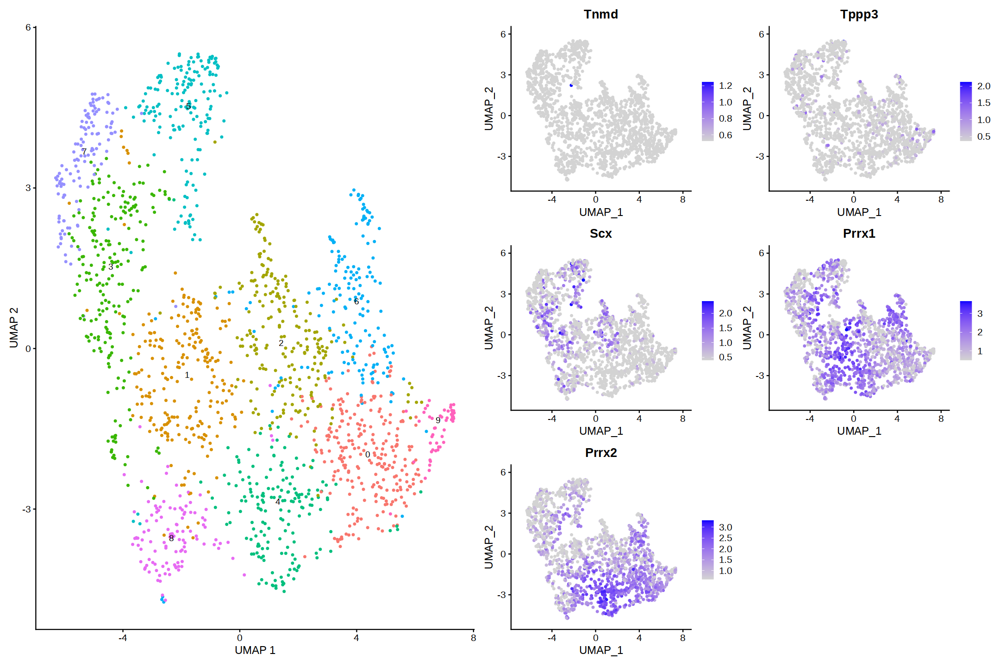

In [140]:
# Tenocyte precursors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Tnmd", "Tppp3", "Scx", "Prrx1", "Prrx2"), min.cutoff = "q1")  

p1 + p2

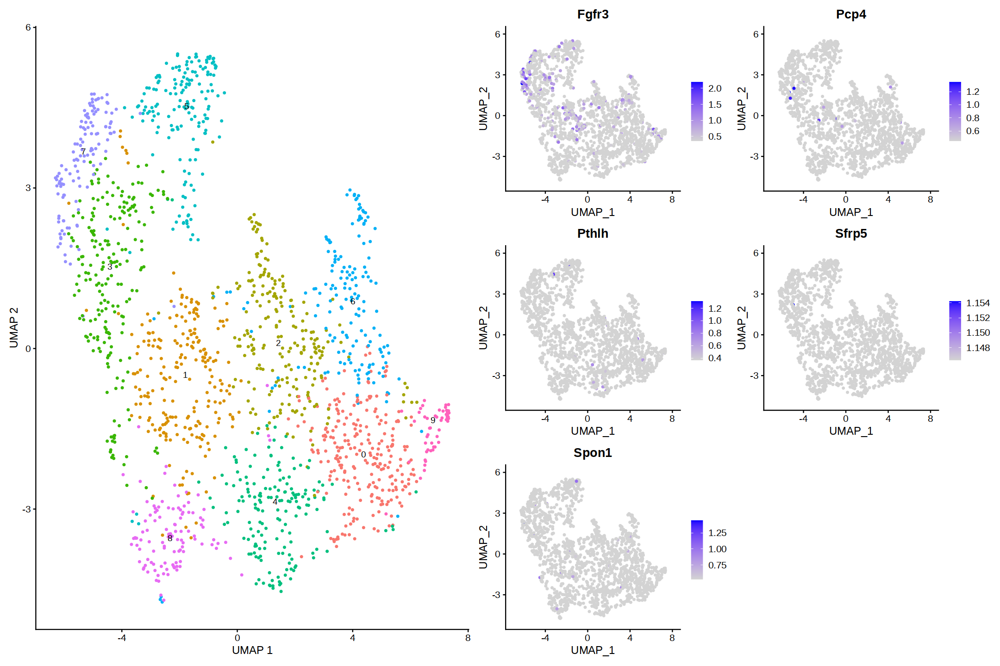

In [84]:
# Resting zone chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Fgfr3", "Pcp4", "Pthlh", "Sfrp5", "Spon1"), min.cutoff = "q1")  

p1 + p2

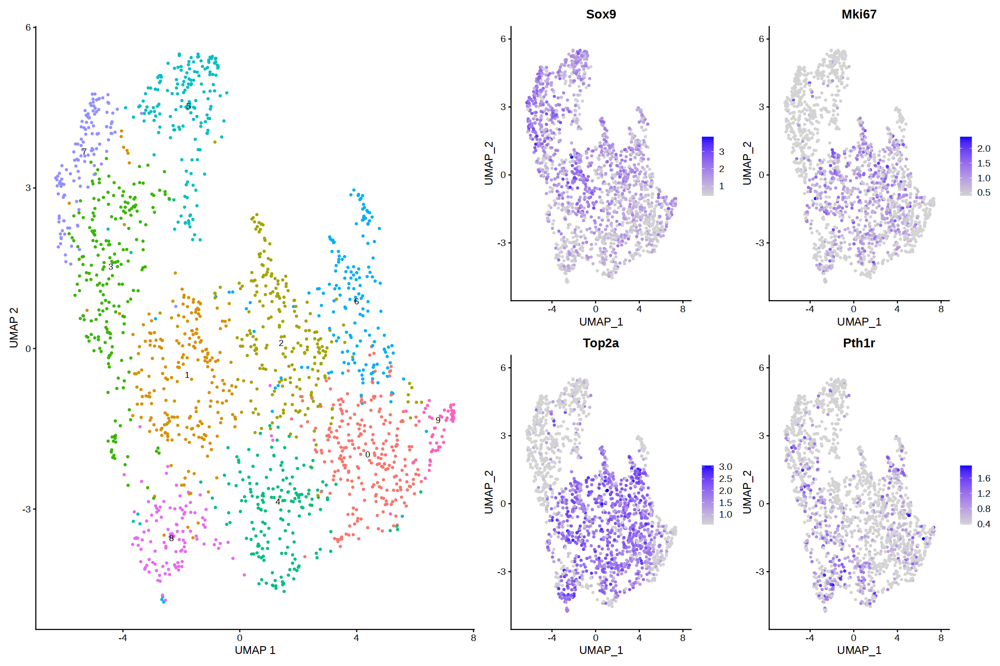

In [85]:
# Proliferative chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Sox9", "Mki67", "Top2a", "Pth1r"), min.cutoff = "q1")  

p1 + p2

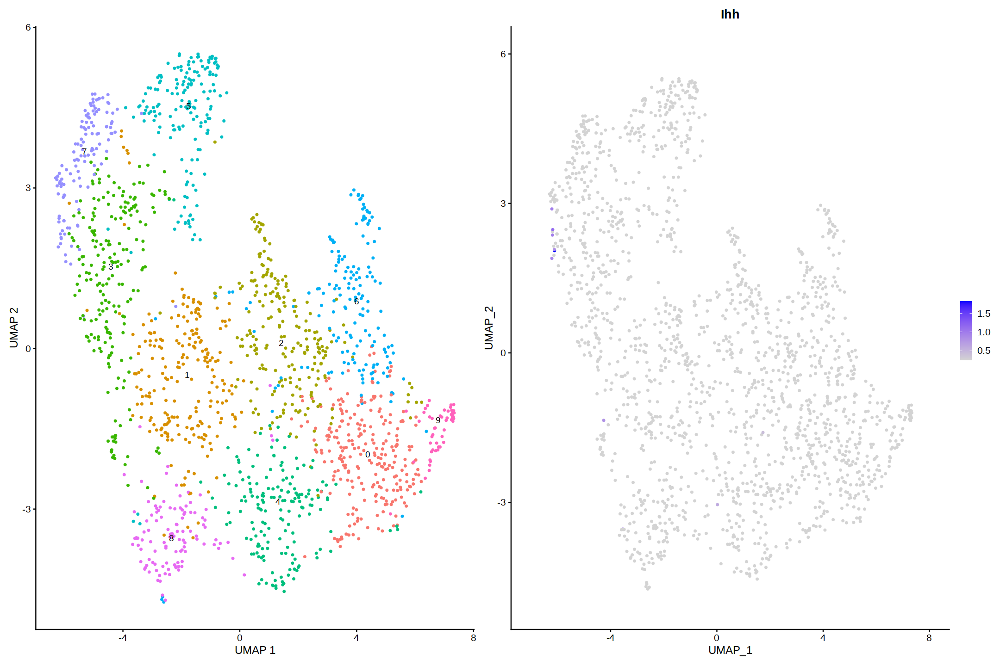

In [86]:
# Pre-hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Ihh"), min.cutoff = "q1")  

p1 + p2

Warning message in FeaturePlot(A_chondrocytes, c("Col10a1"), min.cutoff = "q1"):
“All cells have the same value (1.70470718435615) of Col10a1.”


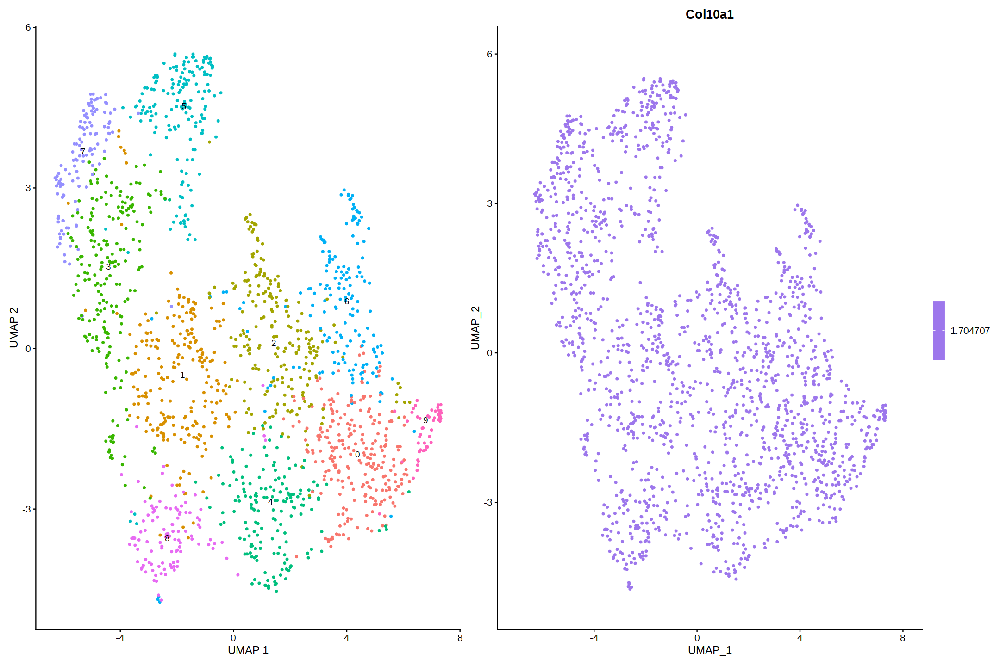

In [87]:
# hypertrophic chondrocytes
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Col10a1"), min.cutoff = "q1")  

p1 + p2

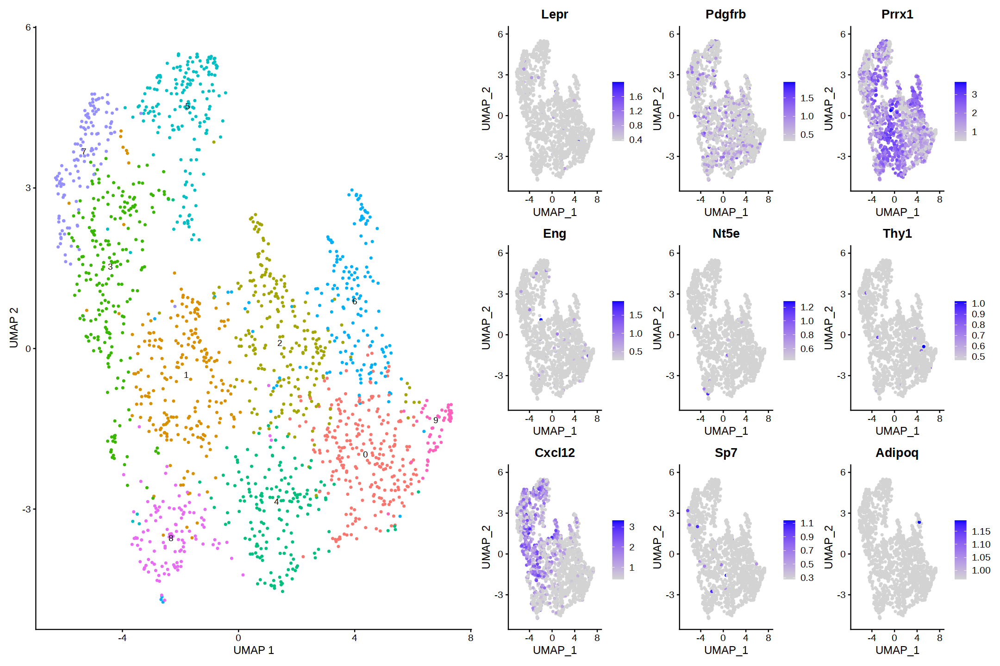

In [89]:
# SSPC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_chondrocytes, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_chondrocytes, c("Lepr","Pdgfrb",'Prrx1',"Eng", "Nt5e", "Thy1","Cxcl12","Sp7","Adipoq"), min.cutoff = "q1") 

p1 + p2

In [141]:
A_chondrocytes@meta.data$CellType_d <- Idents(A_chondrocytes)

In [142]:
A_chondrocytes@meta.data$CellType_d <- as.character(A_chondrocytes@meta.data$CellType_d)

A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '0'] <- 'Distal limb mesenchyme&'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '1'] <- 'Chondroprogenitors'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '2'] <- 'Chondroprogenitors'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '3'] <- 'Tenocyte precursors'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '4'] <- 'Distal limb mesenchyme'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '5'] <- 'Chondroprogenitors'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '6'] <- 'Chondroprogenitors'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '7'] <- 'Resting zone chondrocytes'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '8'] <- 'Proximal limb mesenchyme'
A_chondrocytes@meta.data$CellType_d[A_chondrocytes@meta.data$CellType_d == '9'] <- 'Distal limb mesenchyme'

A_chondrocytes@meta.data$CellType_d <- as.factor(A_chondrocytes@meta.data$CellType_d)

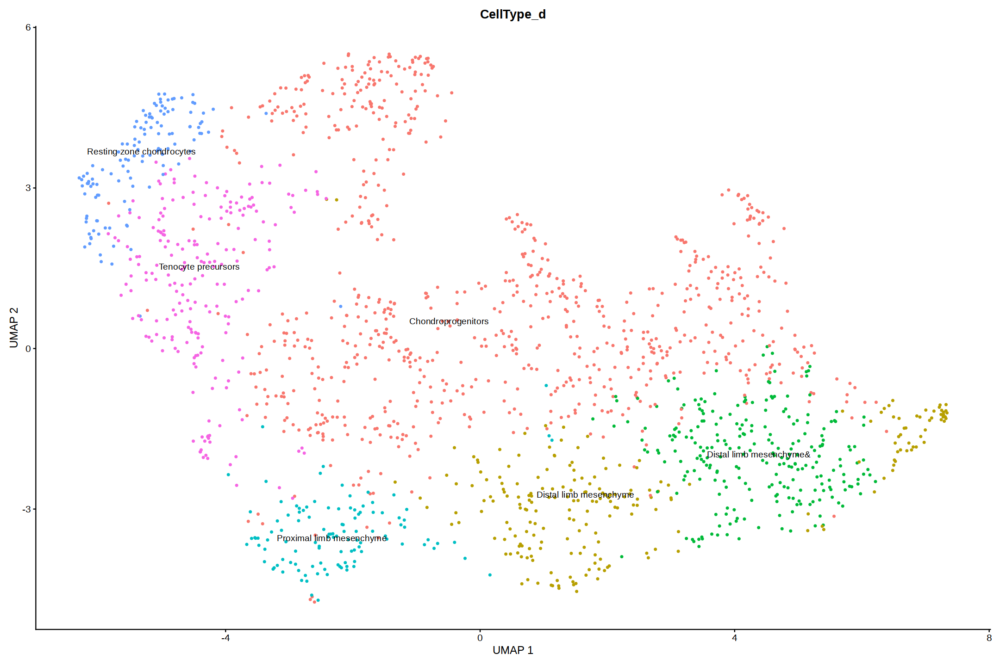

In [143]:
DimPlot(A_chondrocytes, label = TRUE, group.by="CellType_d") + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")

#### 3.4.2. Refinement of global annotations<a id="13.2"></a>
##### 3.4.2.1. Subsetting endothelial clusters<a id="14"></a>

In [147]:
A_myocyte <- subset(A, idents = c("Myocyte"))

In [148]:
A_myocyte

An object of class Seurat 
17008 features across 24 samples within 1 assay 
Active assay: RNA (17008 features, 2000 variable features)
 2 dimensional reductions calculated: pca, umap

In [149]:
A_myocyte <- ScaleData(A_myocyte)

Centering and scaling data matrix



In [150]:
A_myocyte <- RunPCA(A_myocyte, features = VariableFeatures(object = A_myocyte), verbose = FALSE)

ERROR: Error in irlba(A = t(x = object), nv = npcs, ...): max(nu, nv) must be strictly less than min(nrow(A), ncol(A))


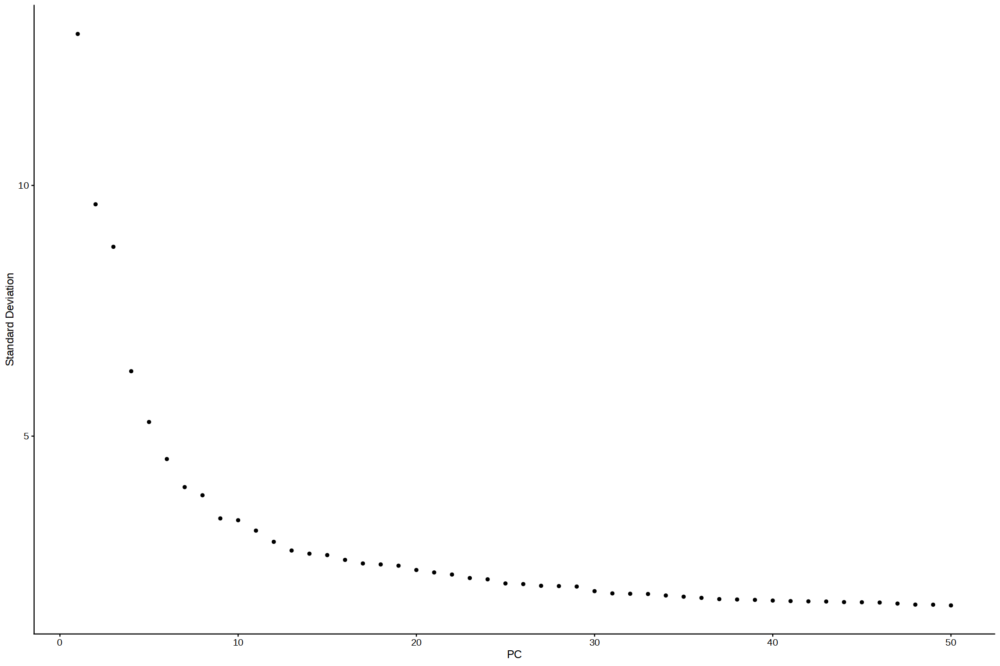

In [151]:
ElbowPlot(A_myocyte, 50)

In [152]:
A_myocyte <- FindNeighbors(A_myocyte, dims = 1:15, verbose = FALSE)
A_myocyte <- FindClusters(A_myocyte, resolution = 0.5, verbose = FALSE)

In [153]:
A_myocyte <- RunUMAP(A_myocyte, dims = 1:15, n.neighbors = 12, verbose = FALSE)

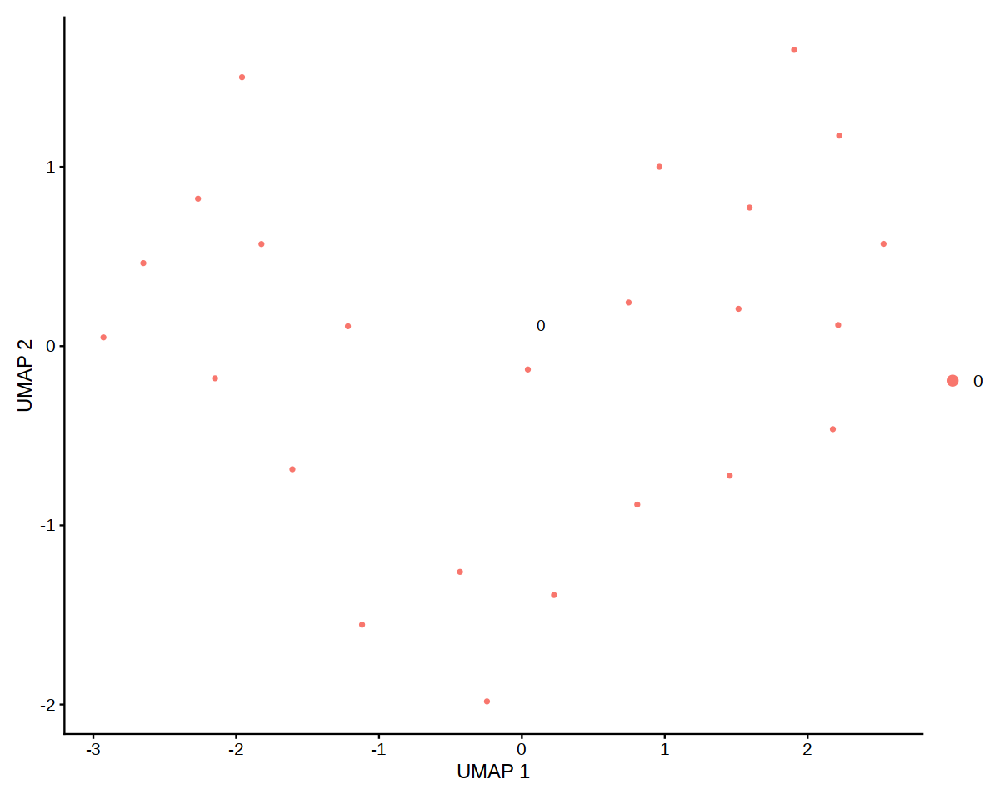

In [154]:
options(repr.plot.width = 10, repr.plot.height = 8)
DimPlot(A_myocyte, reduction = "umap", label=TRUE) + xlab("UMAP 1") + ylab("UMAP 2")

#ggsave("./6-kmita/images/E10_5_m_no_annotation.png" ,width=10, height=8)

In [65]:
A_mesenchyme.markers <- FindAllMarkers(A_mesenchyme)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9



Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Myhc, Mrf4”


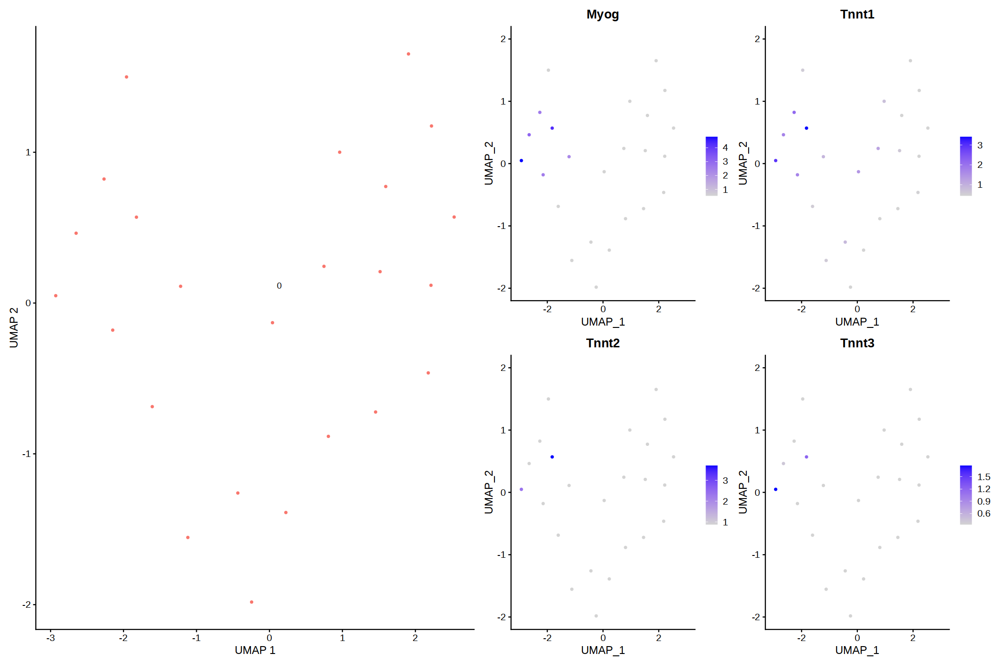

In [155]:
# Skeletal muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Myhc", "Mrf4","Myog",'Tnnt1','Tnnt2','Tnnt3'), min.cutoff = "q1")  

p1 + p2

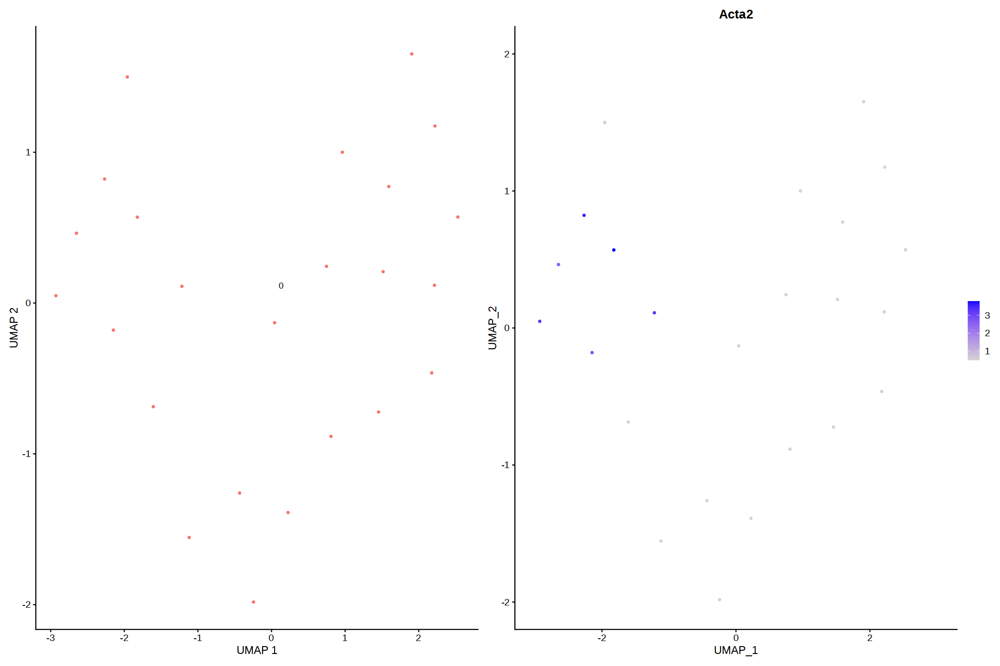

In [156]:
# Smooth muscle cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Acta2"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Pax7”


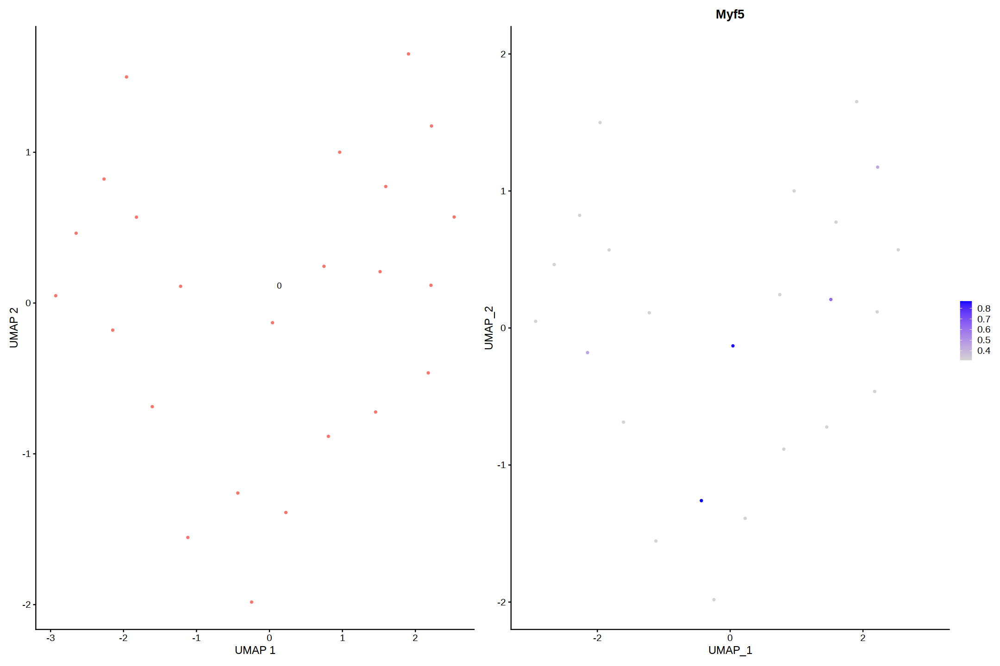

In [158]:
# Myogenic stem cells
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Pax7","Myf5"), min.cutoff = "q1")  

p1 + p2

Warning message in FetchData.Seurat(object = object, vars = c(dims, "ident", features), :
“The following requested variables were not found: Pax7, Notch, Myod”


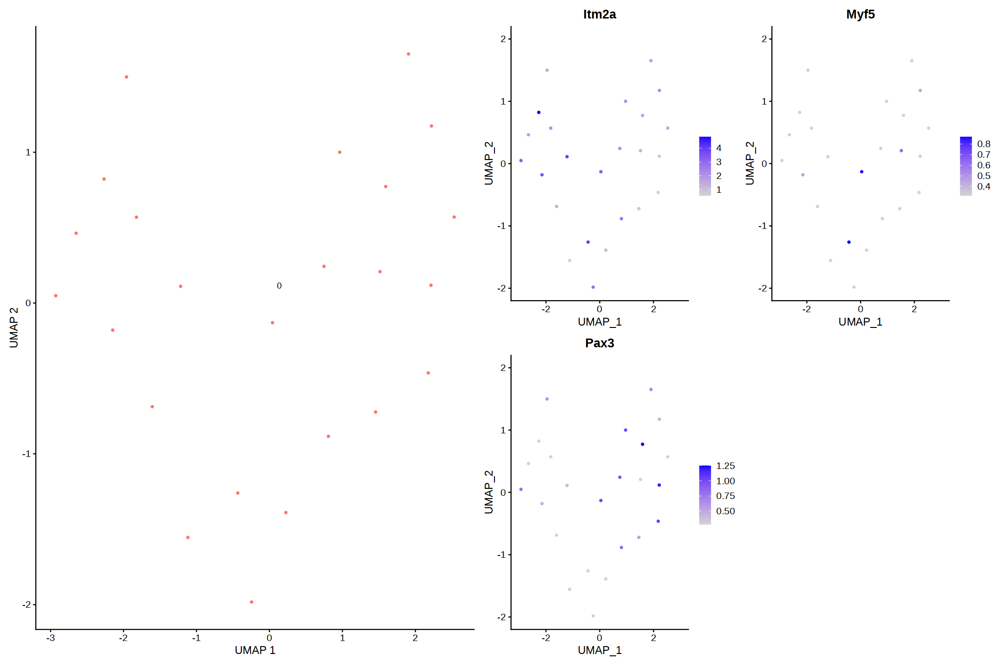

In [160]:
# Muscle progenitors
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_myocyte, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_myocyte, c("Pax7", "Notch", "Itm2a", "Myf5", "Pax3", "Myod"), min.cutoff = "q1")  

p1 + p2

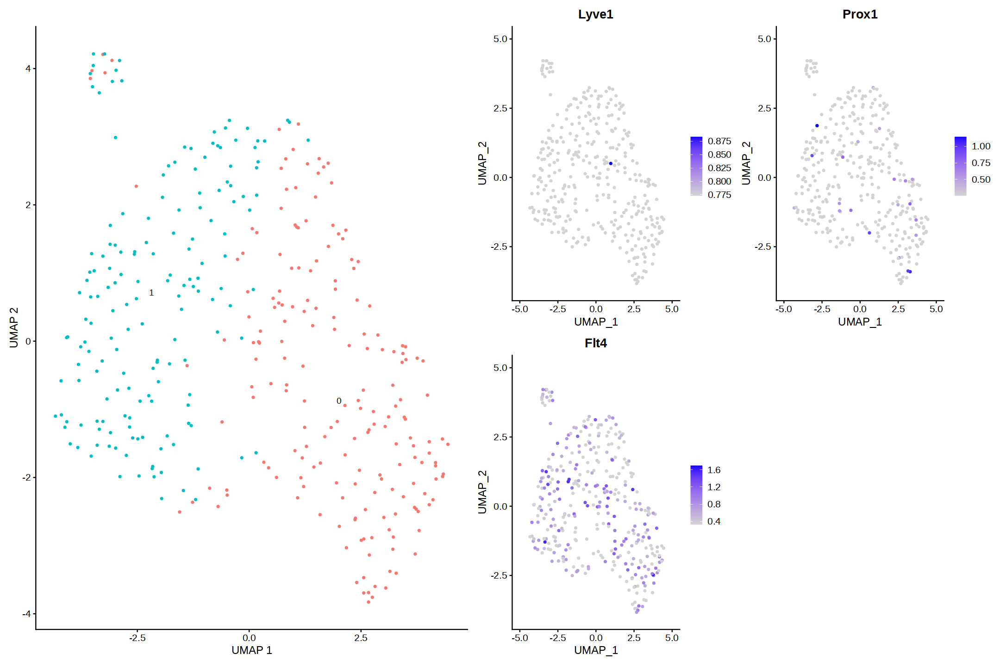

In [117]:
# Lymph vessels
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_endothelium, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_endothelium, c("Lyve1", "Prox1","Flt4"), min.cutoff = "q1")  

p1 + p2

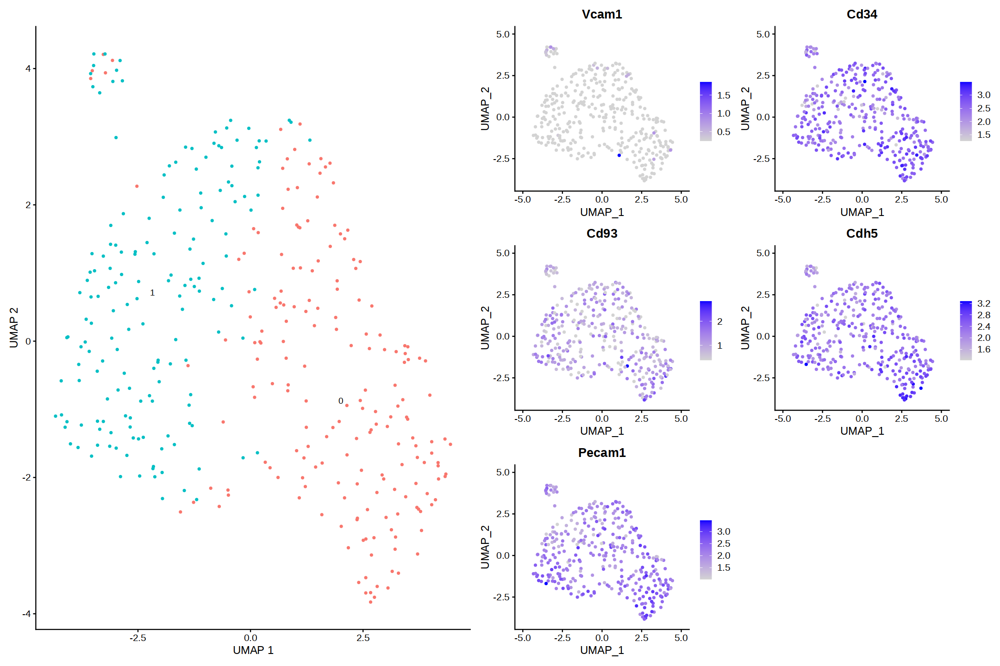

In [119]:
# BEC
options(repr.plot.width = 18, repr.plot.height = 12)

p1 <- DimPlot(A_endothelium, label = TRUE) + NoLegend() + xlab("UMAP 1") + ylab("UMAP 2")
p2 <- FeaturePlot(A_endothelium, c("Vcam1", "Cd34", "Cd93", "Cdh5","Pecam1"), min.cutoff = "q1")  

p1 + p2

#### 3.4.2. Updating annotations<a id="16"></a>

In [203]:
meta1 <- A@meta.data
meta2 <- A_chondrocytes@meta.data

In [204]:
df <- split(meta1, meta1$CellType)

In [205]:
chondro <- rownames(df$Mesenchyme)

In [206]:
chondro_meta <- meta2[chondro, c("CellType_d","Author")]
chondro_meta$Author<- NULL

head(chondro_meta)

,CellType_d
,<fct>
AAACCTGAGACGCACA-1,Chondroprogenitors
AAACCTGCACAGACAG-1,Chondroprogenitors
AAACCTGCAGGCTCAC-1,Chondroprogenitors
AAACCTGTCAAGAAGT-1,Tenocyte precursors
AAACGGGTCAGCTTAG-1,Chondroprogenitors
AAAGATGGTCGATTGT-1,Chondroprogenitors


In [207]:
df$Mesenchyme <- cbind(df$Mesenchyme, chondro_meta)
df$Mesenchyme$CellType <- df$Mesenchyme$CellType_d
df$Mesenchyme$CellType_d <- NULL

In [208]:
df$Ectoderm$Barcode = rownames(df$Ectoderm)
df$Mesenchyme$Barcode = rownames(df$Mesenchyme)
df$'Embryonic skin'$Barcode = rownames(df$'Embryonic skin')
df$AER$Barcode = rownames(df$AER)
df$'Vascular endothelial cells'$Barcode = rownames(df$'Vascular endothelial cells')
df$'Imune cells'$Barcode = rownames(df$'Imune cells')
df$'Muscle progenitors'$Barcode = rownames(df$'Muscle progenitors')

In [209]:
str(df)

List of 7
 $ AER                       :'data.frame':	21 obs. of  25 variables:
  ..$ orig.ident           : Factor w/ 1 level "SeuratProject": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ nCount_RNA           : num [1:21] 7242 5766 11565 5235 6578 ...
  ..$ nFeature_RNA         : int [1:21] 2842 2410 3674 2195 2877 3845 2211 2938 2065 2692 ...
  ..$ geo_accession        : Factor w/ 4 levels "GSM4227224","GSM4227225",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ tissue               : Factor w/ 1 level "hindlimb": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ organism             : Factor w/ 1 level "Mus musculus": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ strain               : Factor w/ 1 level "strain: C57BL/6": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ developmental_stage  : Factor w/ 4 levels "developmental stage: embryonic day 11.5",..: 1 1 1 1 1 1 1 1 1 1 ...
  ..$ instrument_model     : Factor w/ 1 level "Illumina NovaSeq 6000": 1 1 1 1 1 1 1 1 1 1 ...
  ..$ technology           : chr [1:21] "10x 3' v2" "10x 3' v2" "10x 3' v2" "10x 3' v2" ...


In [210]:
names(df)

[1] "AER"                        "Ectoderm"                  
[3] "Embryonic skin"             "Imune cells"               
[5] "Mesenchyme"                 "Muscle progenitors"        
[7] "Vascular endothelial cells"

In [211]:
df$Ectoderm$Barcode <- rownames(df$Ectoderm)
df$Mesenchyme$Barcode <- rownames(df$Mesenchyme)
df$'Embryonic skin'$Barcode <- rownames(df$'Embryonic skin')
df$AER$Barcode <- rownames(df$AER)
df$'Vascular endothelial cells'$Barcode <- rownames(df$'Vascular endothelial cells')
df$'Imune cells'$Barcode <- rownames(df$'Imune cells')
df$'Muscle progenitors'$Barcode <- rownames(df$'Muscle progenitors')

In [212]:
meta.data <- do.call(rbind, df)
rownames(meta.data) = meta.data$Barcode
meta.data$Barcode <- NULL

In [213]:
dim(A@meta.data)
dim(meta.data)

[1] 2453   24

[1] 2453   24

In [214]:
target <- rownames(A@meta.data)
meta.data <- meta.data[match(target, rownames(meta.data)),]

In [215]:
A@meta.data = meta.data

#### 5.4.3. Finalized embedding and annotation<a id="37"></a>

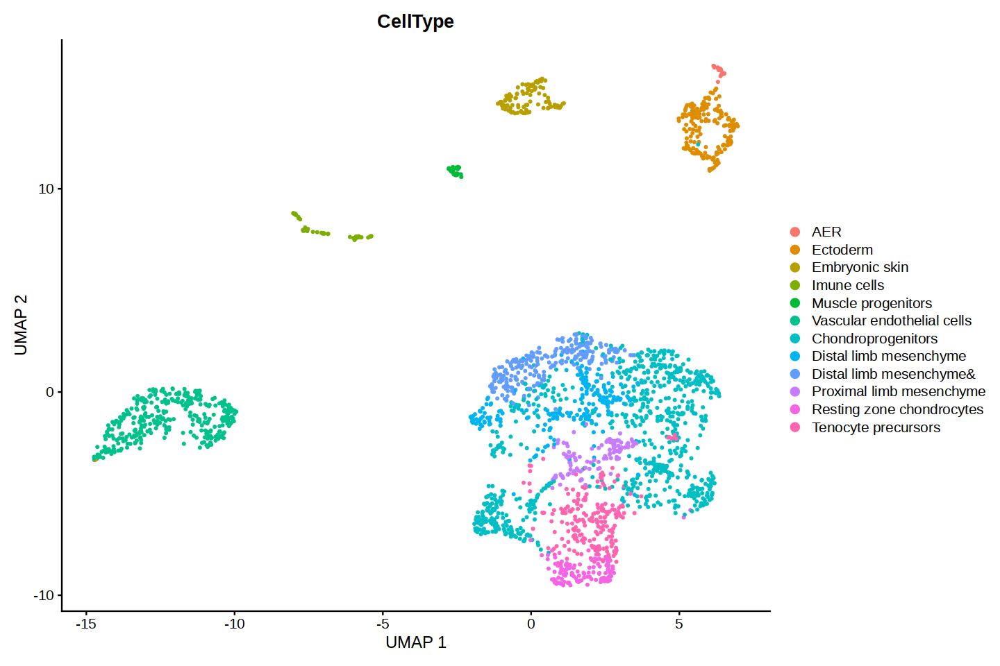

In [216]:
options(repr.plot.width=12)
DimPlot(A, group.by = "CellType", label = FALSE, repel = TRUE) + xlab("UMAP 1") + ylab("UMAP 2")


In [217]:
Idents(A) <- A$CellType

In [219]:
saveRDS(A, file = "Guilak_E11.5_annotated.Rds")